# <img style="float: left; padding-right: 10px; width: 45px" src="https://raw.githubusercontent.com/Harvard-IACS/2018-CS109A/master/content/styles/iacs.png"> Data Science 2: Advanced Topics in Data Science 
## Final Project


**Harvard University**<br/>
**Spring 2022**<br/>
**Instructors**: Mark Glickman & Pavlos Protopapas


<hr style="height:2pt">

# Introduction

The Arms and Armor museum archive is a vast database comprising more than 100,000 Greek vase images alongside their descriptions and various historical data [1].  This archive is structured using machine learning techniques that allow it to be queried with respect to a given vase’s colors, physical features, or descriptor tags [1]. While the Arms and Armor archive is undoubtedly a powerful research tool, its search functionality sometimes falls short. For example, if a vase contains a specific graphical element yet its verbal tag makes no mention of this element, any search for said element will exclude this vase. Accordingly, developing new methods to better classify and describe images at scale could go a long way in improving the archive’s academic value. Our project aims to develop several such methods, by, for example, building three binary classifiers to identify chariots, shields, and satyrs – a type of woodland God – in the archive’s vase imagery. If the accuracy of our resulting model is high, it could be used to classify images of vases that are missing descriptions/verbal tags. Moreover, moving forward we could consider building additional binary classifiers to identify other sorts of categories, such as Gods, warriors, horses, and so on. 

Additionally, we aim to build a clustering tool to systematically group vases together by similar characteristics. Once implemented, this model could be used by researchers to quickly establish top-line relationships within the database.

# Set-up

### Libraries

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import requests
import time
import json

from urllib.request import urlopen
from PIL import Image, ImageOps

from tqdm.auto import notebook_tqdm, trange

# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model
from keras.layers import Input

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
from random import randint
import pickle

import cv2


### Mount drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Load data into dataframe

In [ ]:
'''
def safe_request(link):
    r = requests.get(link)
    time.sleep(2)
    return r
'''

'\ndef safe_request(link):\n    r = requests.get(link)\n    time.sleep(2)\n    return r\n'

In [ ]:
'''
# get first few pages of the API
webpages = []
for page in trange(1,1000):
    link = f"http://armsandarmor.orphe.us/api/items/?format=json&page={page}"
    r = safe_request(link)
    webpage = json.loads(r.text)
    webpages.append(webpage)

# join results of all pages
all_pages = []
for page in webpages:
    all_pages.extend(page['results'])
'''

'\n# get first few pages of the API\nwebpages = []\nfor page in trange(1,1000):\n    link = f"http://armsandarmor.orphe.us/api/items/?format=json&page={page}"\n    r = safe_request(link)\n    webpage = json.loads(r.text)\n    webpages.append(webpage)\n\n# join results of all pages\nall_pages = []\nfor page in webpages:\n    all_pages.extend(page[\'results\'])\n'

In [ ]:

'''
# convert data to df
all_files = []
for i in range(len(all_pages)):
    # extract metadata for vase i
    result = all_pages[i]
    id = result['id']
    data_dict = {'id': id}
    for item in result['metadata']:
        data_dict[item['label']] = item['value']

    # extract image urls for vase i
    # each vase can have multiple images
    for file in result['files']:
        this_file_data = data_dict.copy()
        this_file_data['image'] = file['filepath']
        all_files.append(this_file_data)
df = pd.DataFrame(all_files)  # page 1's DataFrame
'''

"\n# convert data to df\nall_files = []\nfor i in range(len(all_pages)):\n    # extract metadata for vase i\n    result = all_pages[i]\n    id = result['id']\n    data_dict = {'id': id}\n    for item in result['metadata']:\n        data_dict[item['label']] = item['value']\n\n    # extract image urls for vase i\n    # each vase can have multiple images\n    for file in result['files']:\n        this_file_data = data_dict.copy()\n        this_file_data['image'] = file['filepath']\n        all_files.append(this_file_data)\ndf = pd.DataFrame(all_files)  # page 1's DataFrame\n"

### Save images

Get main file path.

In [ ]:
File_Path = "/content/drive/MyDrive/CS_109B_Final_Project/"

Now, we define a cleaning function that takes an image (once it has been retrieved from its given URL), crops it to a square (evenly cutting of equal portions on either side of its longest end), resizing it to a more suitable size (in this case, 128 x 128), and converting it to a numpy array. 

In [ ]:
'''
def clean_image(img, resize_size):
    width, height = img.size
    if width > height:
        extra_space = (width - height) / 2
        top = 0
        bottom = height
        left = extra_space
        right = width - extra_space
    elif height > width:
        extra_space = (height - width) / 2
        top = extra_space
        bottom = height - extra_space
        left = 0
        right = width
    else:
        top = 0
        bottom = height
        left = 0
        right = width
    new = img.crop((left, top, right, bottom))
    new = new.resize((resize_size,resize_size))
    new = ImageOps.grayscale(new)   # grayscale
    new = np.array(new)/255.        # pixel values between 0 and 1
    
    return new

'''

'\ndef clean_image(img, resize_size):\n    width, height = img.size\n    if width > height:\n        extra_space = (width - height) / 2\n        top = 0\n        bottom = height\n        left = extra_space\n        right = width - extra_space\n    elif height > width:\n        extra_space = (height - width) / 2\n        top = extra_space\n        bottom = height - extra_space\n        left = 0\n        right = width\n    else:\n        top = 0\n        bottom = height\n        left = 0\n        right = width\n    new = img.crop((left, top, right, bottom))\n    new = new.resize((resize_size,resize_size))\n    new = ImageOps.grayscale(new)   # grayscale\n    new = np.array(new)/255.        # pixel values between 0 and 1\n    \n    return new\n\n'

In [ ]:
#define resize-size
resize_size = 128

Now, in one fell swoop, we create a copy of the dataframe (limiting it to the first 85k images for storage purposes, then iterate over the img urls, retrieving each image, cropping/resizing it and converting it to numpy array, and storing all these images in a list called clean_images. 

In [ ]:
'''
clean_images = []
new_df = df.copy()
for i,url in enumerate(notebook_tqdm(df['image'])):
    try:
        img = Image.open(urlopen(url))
        img = clean_image(img, resize_size)
        time.sleep(1)  # safe requests!
        clean_images.append(img)
    except:
        print(f"Error with image {i}, removing from dataset.")
        new_df_2 = new_df.drop(i)
print("\n")
new_df_2 = new_df_2.reset_index(drop=True)
plt.imshow(clean_images[0])
'''

'\nclean_images = []\nnew_df = df.copy()\nfor i,url in enumerate(notebook_tqdm(df[\'image\'])):\n    try:\n        img = Image.open(urlopen(url))\n        img = clean_image(img, resize_size)\n        time.sleep(1)  # safe requests!\n        clean_images.append(img)\n    except:\n        print(f"Error with image {i}, removing from dataset.")\n        new_df_2 = new_df.drop(i)\nprint("\n")\nnew_df_2 = new_df_2.reset_index(drop=True)\nplt.imshow(clean_images[0])\n'

Run the cell below only once. It saves the dataframe with image information to a folder in our drive. 



In [ ]:
'''
File_Path_2 = "/content/drive/MyDrive/CS_109B_Final_Project/saved_df/"
new_df_2.to_csv(File_Path_2 + 'new_df_large_complete_2.csv')
'''

'\nFile_Path_2 = "/content/drive/MyDrive/CS_109B_Final_Project/saved_df/"\nnew_df_2.to_csv(File_Path_2 + \'new_df_large_complete_2.csv\')\n'

Run the cell below only once. It saves the immage arrays into batches of 10k so that we can load them later. 

In [ ]:
'''
File_Path_3 = "/content/drive/MyDrive/CS_109B_Final_Project/cs109b_clean_imgs/"

#np.save(File_Path_3 + 'clean_images_complete_2_0.npy', clean_images[0:10000])
#np.save(File_Path_3 + 'clean_images_complete_2_1.npy', clean_images[10000:20000])
#np.save(File_Path_3 + 'clean_images_complete_2_2.npy', clean_images[20000:30000])
#np.save(File_Path_3 + 'clean_images_complete_2_3.npy', clean_images[30000:40000])
#np.save(File_Path_3 + 'clean_images_complete_2_4.npy', clean_images[40000:50000])
#np.save(File_Path_3 + 'clean_images_complete_2_5.npy', clean_images[50000:60000])
#np.save(File_Path_3 + 'clean_images_complete_2_6.npy', clean_images[60000:70000])
#np.save(File_Path_3 + 'clean_images_complete_2_7.npy', clean_images[70000:80000])
#np.save(File_Path_3 + 'clean_images_complete_2_8.npy', clean_images[80000:])

'''

'\nFile_Path_3 = "/content/drive/MyDrive/CS_109B_Final_Project/cs109b_clean_imgs/"\n\n#np.save(File_Path_3 + \'clean_images_complete_2_0.npy\', clean_images[0:10000])\n#np.save(File_Path_3 + \'clean_images_complete_2_1.npy\', clean_images[10000:20000])\n#np.save(File_Path_3 + \'clean_images_complete_2_2.npy\', clean_images[20000:30000])\n#np.save(File_Path_3 + \'clean_images_complete_2_3.npy\', clean_images[30000:40000])\n#np.save(File_Path_3 + \'clean_images_complete_2_4.npy\', clean_images[40000:50000])\n#np.save(File_Path_3 + \'clean_images_complete_2_5.npy\', clean_images[50000:60000])\n#np.save(File_Path_3 + \'clean_images_complete_2_6.npy\', clean_images[60000:70000])\n#np.save(File_Path_3 + \'clean_images_complete_2_7.npy\', clean_images[70000:80000])\n#np.save(File_Path_3 + \'clean_images_complete_2_8.npy\', clean_images[80000:])\n\n'

### Access images and dataframes

If there is a folder with the images and dataframe, run the cell below instead to load them in.

In [ ]:
#ensure file paths are same
File_Path_2 = "/content/drive/MyDrive/CS_109B_Final_Project/saved_df/"
File_Path_3 = "/content/drive/MyDrive/CS_109B_Final_Project/cs109b_clean_imgs/"

In [ ]:
# Read df -- will have 85k rows 
new_df = pd.read_csv(File_Path_2 + 'new_df_large_complete_2.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (15,20) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
#define num batches
#MAKE THIS SMALLER FOR NOW, ANYTHING <= 3 WON"T CRASH
num_batches = 2

for i in range(0,num_batches):
  batch_i = File_Path_3 + 'clean_images_complete_2_' + str(i) + '.npy'
  batch_load = np.load(batch_i)

  if i == 0:
    clean_images = batch_load
  else:
    clean_images = np.vstack((clean_images, batch_load))
  
  del batch_load

In [ ]:
len(clean_images)

20000

Make sure dataframe is only as long as the number of images we have.

In [ ]:
#make sure dataframe is only as long as the number of images we have 
new_df = new_df.iloc[:len(clean_images)]

print(f'Shape of dataframe: {new_df.shape}')
print(f'Number of images: {len(clean_images)}')

Shape of dataframe: (20000, 21)
Number of images: 20000


# Clustering Analysis

We start with our images dataset. 

In [ ]:
#type(clean_images)
print(clean_images.shape)
clean_images_2 = clean_images[0:2500,:,:]
print(clean_images_2.shape)


(10000, 128, 128)
(2500, 128, 128)


We then load a VGG16 model pretrained on the ImageNet dataset. We have the output of our model be the second to last layer in the original model - it is a fully connected layer with 4096 output nodes. This creates a feature vector of size 4096 that we will us to cluster our vase images. I learned about this technique from a towards data science tutorial! 

In [ ]:
# load the model first and pass as an argument
model_start = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(128, 128, 3)))
print(model_start.summary())
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)
print(model.summary())

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0     

Our "extract_features" method takes in an image file and returns a vector of features. We processed every image in our clean_images dataset and stored it in our all_features list. 

In [ ]:
def extract_features(file, model):
    img = np.array(file) #img = np.array(img) 
    img_new = np.stack((img,)*3, axis=-1) #converting to 3 channel 
    img = img_new
    reshaped_img = img.reshape(1,128,128,3) # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    imgx = preprocess_input(reshaped_img) # prepare image for mode
    features = model.predict(imgx, use_multiprocessing=True) # get the feature vector
    return features

In [ ]:
all_features = []

In [ ]:
# lop through each image in the dataset
vase_feature_process_counter = 1
for vase in clean_images_2:
  feat = extract_features(vase,model)
  all_features.append(feat)
  vase_feature_process_counter += 1

In [ ]:
feat = np.asarray(all_features)
feat = feat.reshape(-1,4096)

We then performed Principal Component Analysis, which reduces the dimension of the feature vector. 

In [ ]:
# reduce the amount of dimensions in the feature vector
pca = PCA(n_components=100, random_state=109)
pca.fit(feat)
x = pca.transform(feat)

Next, we want to decide how many clusters to perform KMeans Clustering with. We used the three ways we discussed in class - elbow plot, silhoutte analysis, and gap clustering! 

First, we try the elbow method plot. 

In [ ]:
#elbow plot (from lecture):
wss = []
n_clusters_to_try = 20
for i in range(1,n_clusters_to_try + 1):
    fitx = KMeans(n_clusters=i, init='random', n_init=42, random_state=109).fit(x)
    wss.append(fitx.inertia_)

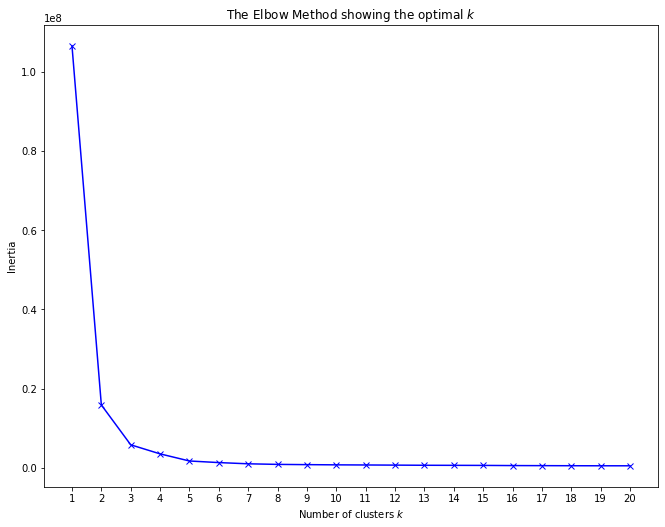

In [ ]:
plt.figure(figsize=(11,8.5))
plt.plot(range(1,n_clusters_to_try+1), wss, 'bx-')
plt.xlabel('Number of clusters $k$')
plt.ylabel('Inertia')
plt.title('The Elbow Method showing the optimal $k$')
plt.xticks(range(1, n_clusters_to_try+1))
plt.show()

This elbow plot suggests our optimal number of clusters are either 2 or 3. 

Next, we try the Silhoutte Method metric. 

Optimized at 3 clusters


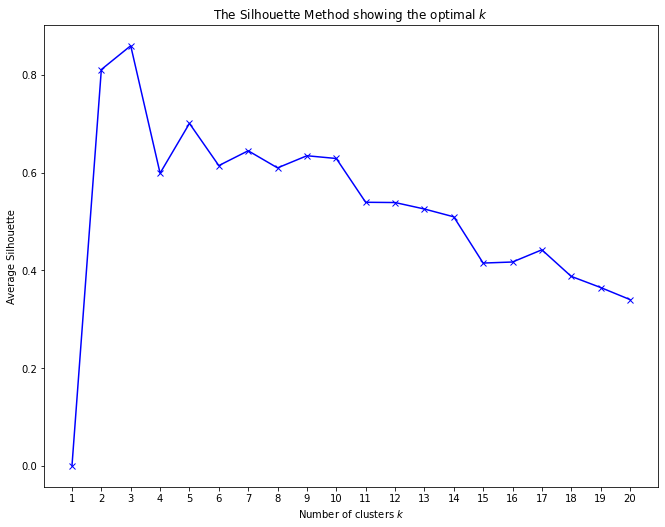

In [ ]:
from sklearn.metrics import silhouette_score

n_clusters_to_try = 20

scores = [0]  # silhouette score for 1 cluster
for i in range(2,n_clusters_to_try+1):
    fitx = KMeans(n_clusters=i, init='random', n_init=5, random_state=109).fit(x)
    score = silhouette_score(x, fitx.labels_)
    scores.append(score)

print("Optimized at", max(range(len(scores)), key=scores.__getitem__)+1, "clusters")
    
plt.figure(figsize=(11,8.5))
plt.plot(range(1,n_clusters_to_try+1), np.array(scores), 'bx-')
plt.xlabel('Number of clusters $k$')
plt.ylabel('Average Silhouette')
plt.title('The Silhouette Method showing the optimal $k$')
plt.xticks(range(1, n_clusters_to_try+1))
plt.show()

The silhoutte plot metric suggests our ideal number of clusters should be 3. 

Next, we try the gap statistic metric. 

In [ ]:
# need to install library 'gap-stat'
from gap_statistic import OptimalK

n_clusters_to_try = 5

gs_obj = OptimalK()

n_clusters = gs_obj(x, n_refs=50, cluster_array=np.arange(1, n_clusters_to_try+1))

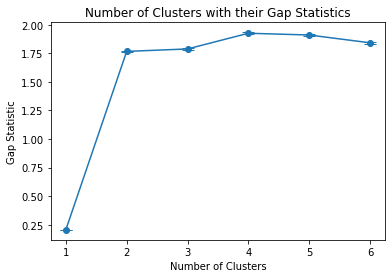

In [ ]:
def display_gapstat_with_errbars(gap_df):
    gaps = gap_df["gap_value"].values
    diffs = gap_df["diff"]
    
    err_bars = np.zeros(len(gap_df))
    err_bars[1:] = diffs[:-1] - gaps[:-1] + gaps[1:]

    plt.scatter(gap_df["n_clusters"], gap_df["gap_value"])
    plt.errorbar(gap_df["n_clusters"], gap_df["gap_value"], yerr=err_bars, capsize=6)
    plt.xlabel("Number of Clusters")
    plt.ylabel("Gap Statistic")
    plt.xticks(range(1, n_clusters_to_try+1))
    plt.title("Number of Clusters with their Gap Statistics")
    plt.show()
    
display_gapstat_with_errbars(gs_obj.gap_df)

For the Gap Statistic, we use the rule $Gap(K) ≥ Gap(K + 1) − s_{K+1}$ equation we learned and find that 4 seems to satisfy the condition for the optimal number of clusters. Two clusters also seems like a viable option, but it is unclear whether the error bar for 3 clusters is low enough for the point of 2 clusters to be above it. In the appendix, we consider these two options and include the outputs of the silhouette analysis for these at the end of the this section.


We decide to use k = 3 for K-Means clustering based on the metrics and collect the clustered data into a dictionary. 

In [ ]:
# cluster feature vectors
kmeans_3 = KMeans(n_clusters=3, random_state=109)
kmeans_3.fit(x)



KMeans(n_clusters=3, random_state=109)

In [ ]:
# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(clean_images_2,kmeans_3.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)



In [ ]:
# function that lets you view a cluster (based on identifier)        
def view_cluster(cluster):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:29]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = file #img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

Clipping cluster size from 1875 to 30


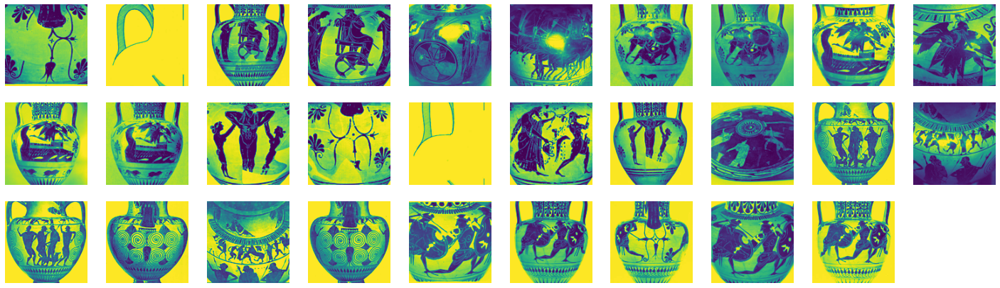

In [ ]:
view_cluster(0)

Clipping cluster size from 313 to 30


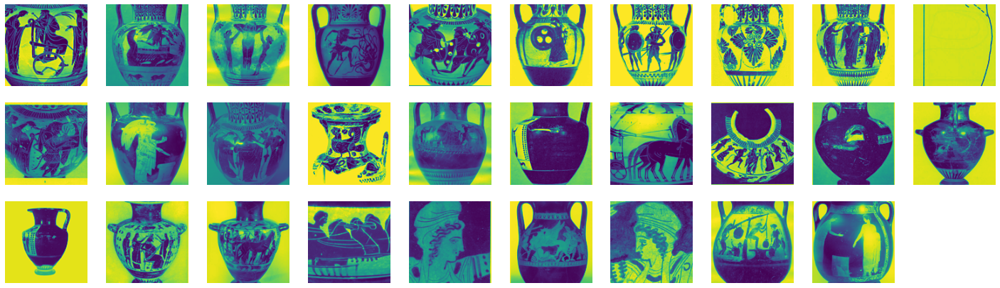

In [ ]:
view_cluster(1)

Clipping cluster size from 312 to 30


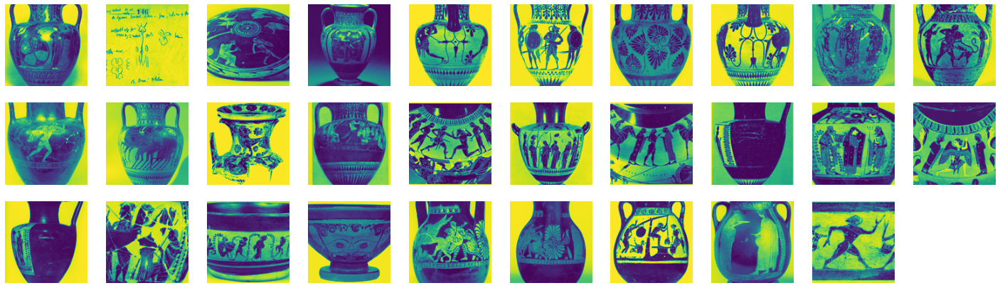

In [ ]:
view_cluster(2)

Visually analyzing some of our results, we see that the clusters don't have immediate or obvious similarities. This brings us back to the difficulties of clustering with limited data. Looking closer, we can see that the second cluster has more images of zoomed-in faces on vases while the others don't. Additionally, we see that the first cluster has the highest concentration of "heart-shaped" vases, while the others have a distinctly different more oval, vertically-elongated shape. 

We also decide to use a silhouttee plot to analyze the clustering, and see that it performs pretty well in this analysis.

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
#modified code from http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

def silplot(X, cluster_labels, clusterer, pointlabels=None):
    n_clusters = clusterer.n_clusters
    
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(11,8.5)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters = ", n_clusters,
          ", the average silhouette_score is ", silhouette_avg,".",sep="")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(0,n_clusters+1):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    
    # axes will be first 2 PCA components
    pca = PCA(n_components=2).fit(X)
    X_pca = pca.transform(X) 
    ax2.scatter(X_pca[:, 0], X_pca[:, 1], marker='.', s=200, lw=0, alpha=0.7,
                c=colors, edgecolor='k')
    xs = X_pca[:, 0]
    ys = X_pca[:, 1]    

    
    if pointlabels is not None:
        for i in range(len(xs)):
            plt.text(xs[i],ys[i],pointlabels[i])

    # Labeling the clusters (transform to PCA space for plotting)
    centers = pca.transform(clusterer.cluster_centers_)
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % int(i), alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("PC1")
    ax2.set_ylabel("PC2")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

For n_clusters = 3, the average silhouette_score is 0.85969627.


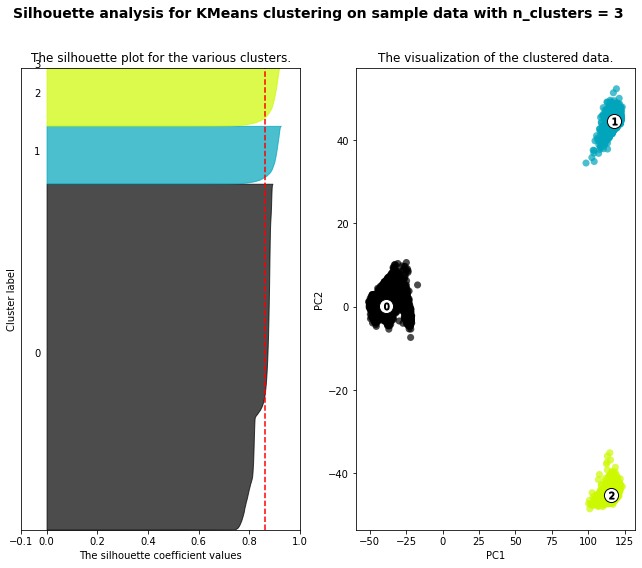

In [ ]:
silplot(x, kmeans_3.labels_, kmeans_3)

In the silhoutte analysis plots for K = 2 and K = 4 (code and visual results included in the appendix), we can also see a pretty clear suggestion that there should be 3 clusters. 


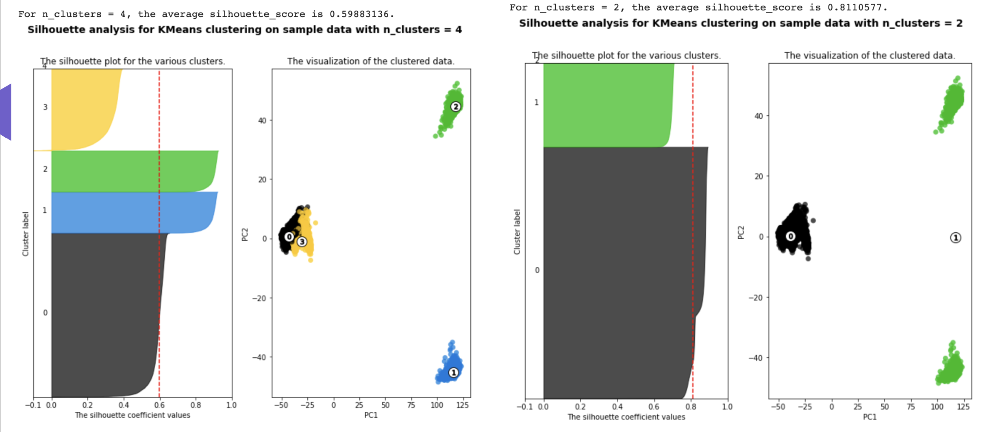

We now move on to more advanced modeling techniques and try to set up our data to run our binary classification models. 

# Exploratory data analysis

## General exploratory data analysis

### Image samples

Since the images have already been cleaned, let's begin by viewing some of them. 

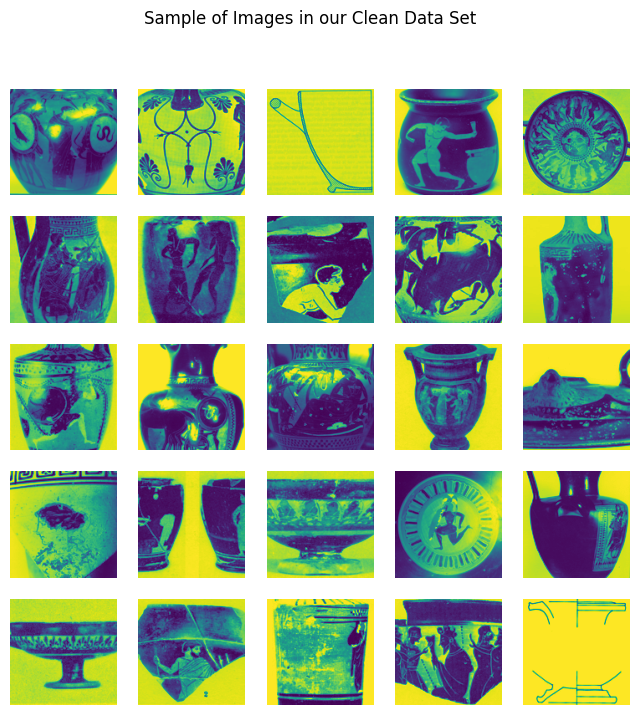

In [ ]:
# Visualize all images
plt.style.use('default')
fig, axs = plt.subplots(5,5,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Sample of Images in our Clean Data Set")
for i,ax in enumerate(axs.flat):
    ax.imshow(clean_images[np.random.choice(len(clean_images))])
    ax.axis('off')

Now, let's look at some visualizations of the data. 

### Vase distributions and histograms

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  


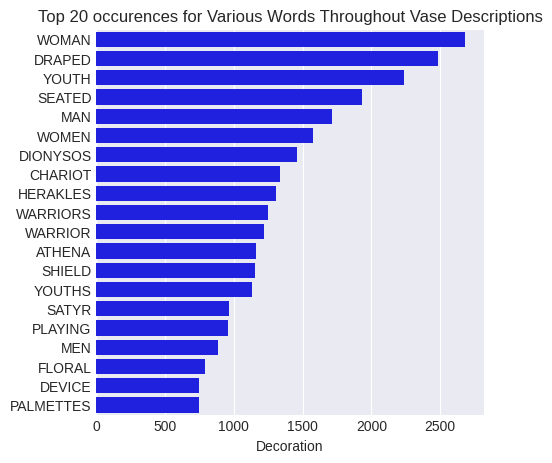

In [ ]:
# Get all counts
counts = new_df['Decoration'].str.replace(r'[():,.!?\\-]', ' ')
counts = counts.str.split().explode().value_counts()

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['AND', 'A', 'IN', 'OF', 
                  'AB', 'THE', 'ON', 'AT',
                  'ONE', 'B', 'body', 'I', 
                  'WITH', 'Body', 'BETWEEN']

# Get top20 counts
cond = counts.index.isin(stoppage_words)
counts = counts[~cond]
counts = counts.sort_values(ascending=False)[:20]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 20 occurences for Various Words Throughout Vase Descriptions")
sns.barplot(y = counts.index, x =counts, color = 'blue')

plt.show()

del counts

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  


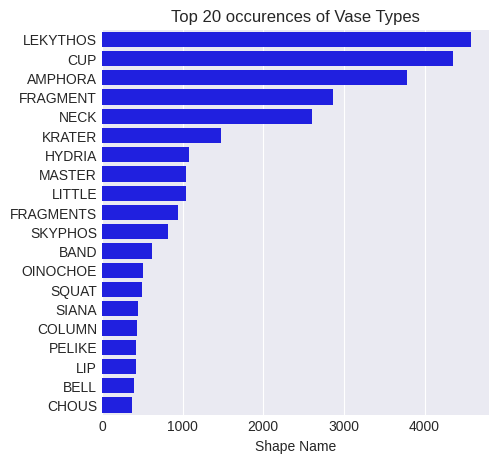

In [ ]:
# Get all counts for vase types
counts = new_df['Shape Name'].str.replace(r'[():,.!?\\-]', '')
counts = counts.str.split().explode().value_counts()

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['A', 'B']

# Get top20 counts
cond = counts.index.isin(stoppage_words)
counts = counts[~cond].sort_values(ascending=False)[:20]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 20 occurences of Vase Types")
sns.barplot(y=counts.index,x=counts, axes=ax, color = "blue")

plt.show()

del counts

In [ ]:
############################## DELETE ???
#########################################

'''
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(x="Shape Name", data= new_df, axes=ax)
ax.set_title("Shape Name for Data Set")
ax.set_xticks([])

'''

'\nplt.style.use(\'seaborn-darkgrid\')# Plot\nfig, ax = plt.subplots(1, 1, figsize=(5,5))\nsns.countplot(x="Shape Name", data= new_df, axes=ax)\nax.set_title("Shape Name for Data Set")\nax.set_xticks([])\n\n'

There seems to be a healthy distribution of various types of Shapes. Now let's look at techniques used. 

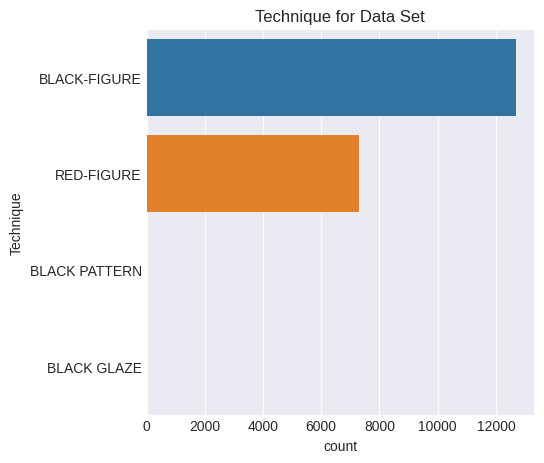

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Technique", data= new_df)
ax.set_title("Technique for Data Set")
#ax.set_xticklabels(ax.get_xticklabels(), rotation = 30, axes=ax)
plt.show()

From the above, it is clear we are mostly dealing with Black-Figures and Red-Figures. 

[]

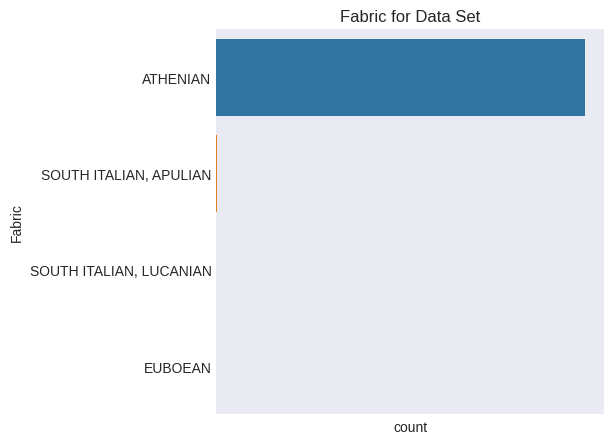

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Fabric", data= new_df, axes=ax)
ax.set_title("Fabric for Data Set")
ax.set_xticks([])

### Dealing with Missingness

Now, we will take a look at the vase images that did not have any descriptions in the 'Decoration' column. Since these columns will be used to define whether or not there is a certain feature – shield, satyr, chariot – etc., if it is NA, then the eventual shield, satyr, chariot column will be NA too. So let's handle those scenarios. 

In [ ]:
# Check vases that have missing descriptions
missing_description_indices = new_df.index[new_df['Decoration'].isna()].tolist()

# See number of missing descriptions
num_missing = len(missing_description_indices)
print("Number of missing descriptions: ", num_missing)

Number of missing descriptions:  1446


In [ ]:
new_df.iloc[missing_description_indices,:].head()

,Unnamed: 0,Unnamed: 0.1,id,Source ID,Vase Number,Fabric,Technique,Shape Name,Date,Attributed To,...,Publication Record,Pleiades URI,Color,Provenance,LIMC ID,LIMC Web,CAVI Collection,image,Transcription,TranscriptionTrimmed
50,50,50,9356,{71D8B7B5-73AC-4913-86D5-FB150CA21401},27,ATHENIAN,BLACK-FIGURE,"AMPHORA, NECK FRAGMENT",-550 to -500,NaN,...,"Christie, Manson and Woods, sale catalogue: 12...",None,Grey,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/oUxmdMYH...,NaN,NaN
65,65,65,9359,{681C60DE-2285-44F0-A175-92A3C9C145C8},30,ATHENIAN,BLACK-FIGURE,"AMPHORA, NECK FRAGMENT",-525 to -475,LYSIPPIDES P by BOARDMAN,...,"Christie, Manson and Woods, sale catalogue: 2....",None,Grey,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/7y4U3Tnr...,NaN,NaN
227,227,227,9483,{6FAC8A3D-60AD-4AFE-9A53-E41748396316},155,ATHENIAN,BLACK-FIGURE,"KRATER, COLUMN FRAGMENT",NaN,NaN,...,NaN,https://pleiades.stoa.org/places/727169,Grey,"EGYPT, NAUCRATIS",NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/2qEzhnQS...,NaN,NaN
228,228,228,9486,{334A2066-D957-426C-A3C9-A384E9B2D5D8},158,ATHENIAN,BLACK-FIGURE,CUP LITTLE MASTER BAND FRAGMENT,NaN,NaN,...,"Bulletin Antieke Beschaving: 68 (1993) 138, FI...",https://pleiades.stoa.org/places/727169,Grey,"EGYPT, NAUCRATIS",NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/XWnwsqTj...,NaN,NaN
239,239,239,9496,{11454F77-1281-454C-9FBB-05A6C0934206},169,ATHENIAN,BLACK-FIGURE,CUP LITTLE MASTER BAND FRAGMENT,NaN,NaN,...,NaN,https://pleiades.stoa.org/places/422859,Grey,"ITALY, ETRURIA, CERVETERI (?)",NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/koEL3Qdq...,NaN,NaN


Let's see the distribution of the vases that have missing descriptions info with respect to various other descriptors

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The default value of regex will change from True to False in a future version.
  import sys


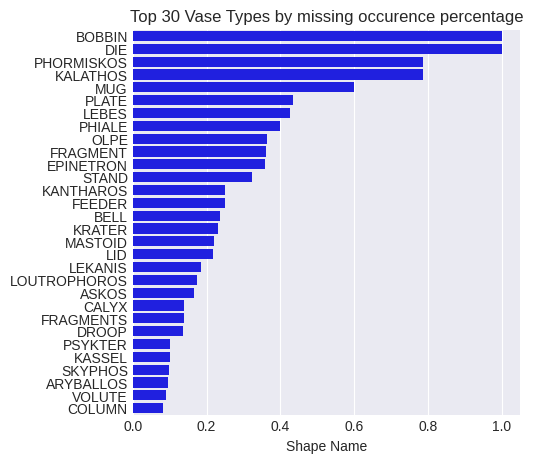

In [ ]:
# Get missing counts
missing = new_df.iloc[missing_description_indices,:]
missing = missing['Shape Name'].str.replace(r'[():,.!?\\-]', '')
missing = missing.str.split().explode().value_counts()

# Get total counts
counts = new_df['Shape Name'].str.replace(r'[():,.!?\\-]', '')
counts = counts.str.split().explode().value_counts()

# Get missing percentage
percent = missing / counts

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['A', 'B']

# Get top20 counts with missing
cond = percent.index.isin(stoppage_words)
percent = percent[~cond].sort_values(ascending=False)[:30]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 30 Vase Types by missing occurence percentage")
sns.barplot(y=percent.index,x=percent, axes=ax, color = 'blue')

plt.show()

del percent

Let's also look at fabric and technique.

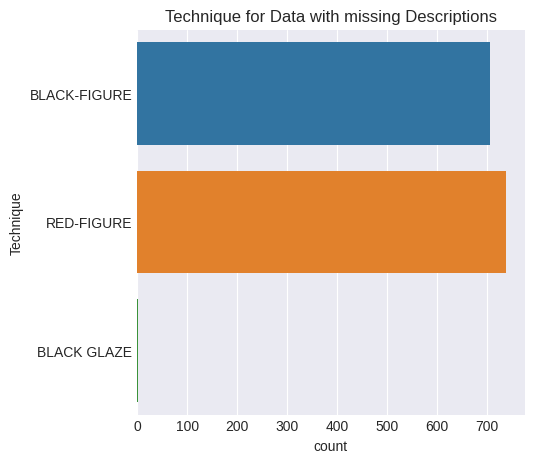

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Technique", data= new_df.iloc[missing_description_indices,:], axes=ax)
ax.set_title("Technique for Data with missing Descriptions")
plt.show()

Interestingly, they seem mostly to be red-figures, but black-figures are well'represented too. Finally, let's check Fabric. 

Text(0.5, 1.0, 'Fabric for Data with missing Descriptions')

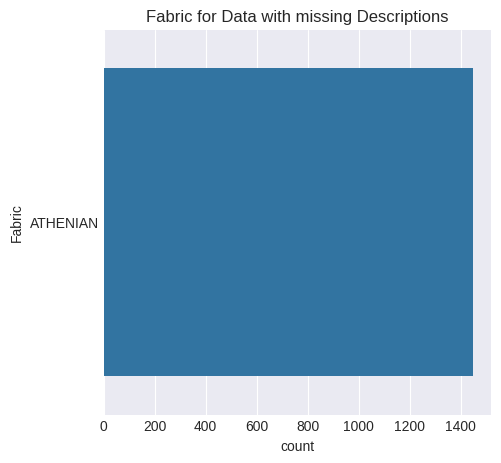

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Fabric", data= new_df.iloc[missing_description_indices,:], axes=ax)
ax.set_title("Fabric for Data with missing Descriptions")

From above, we see that, while the vases with missing descriptors are mostly composed of Athenian vases, so, too, is the whole dataset, so there isn't any correlation between missingness and Fabric. 

Now, we will analyse the images that are missing. We can see that the images that are missing look like fragments and none of them appear to show chariots. Furthermore, the number is a neglegible amount. This means we can ignore them safely.

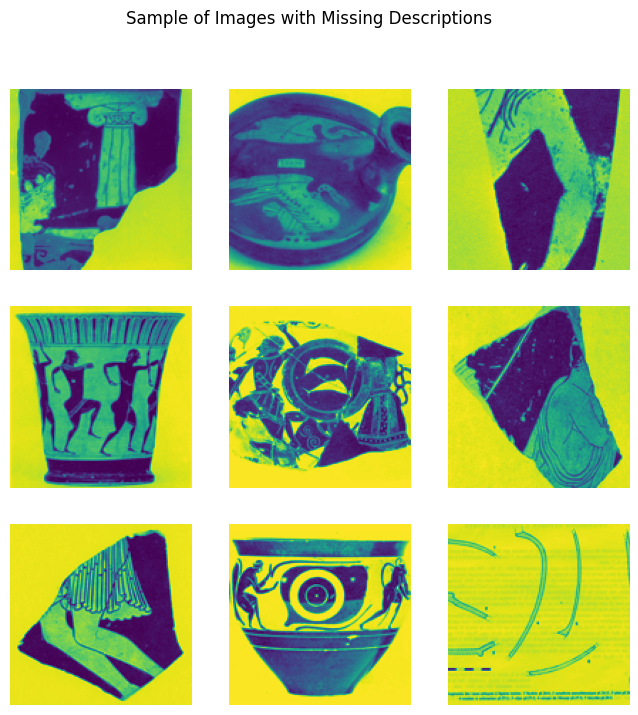

In [ ]:
# Let's now look at some missing images
plt.style.use('default')
fig, axs = plt.subplots(3,3,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Sample of Images with Missing Descriptions")
for i,ax in enumerate(axs.flat):
    ax.imshow(clean_images[np.random.choice(missing_description_indices[:100], replace = False)])
    ax.axis('off')

Missingness neglegible and not at random. Just drop.

In [ ]:
# Drop missing values
notna = ~new_df['Decoration'].isna()
notna_idx = notna[notna].index.tolist()

new_df = new_df.dropna(subset=['Decoration'])
new_df = new_df.reset_index(drop = True)
clean_images = np.array(clean_images)[notna_idx]

For all the other  images, we have information such as the origin, the type of vase, color, provenance, and a decoration column that contains a description of the vase. 

### Defining New Columns

For our project we will focus on binary classifications of different objects, specifically shields, satyrs, and chariots. To choose the outcome of interest, we look through the descriptions of the images and choose one that we would be able to check visually when we compare predictions and outcomes. While chariot, satyr, and shield, are not the most common words, they are still used relatively often. We chose objects that we would be able to check visually when we compare predictions and outcomes. It might be hard for us to distinguish Dionysus from other Greek gods if there is no 
mention of a person in the description and there is someone.  


To create our outcome for the classifier, we look at the “Decoration” column in our dataframe and create a new column that is an indicator for whether the word chariot appears in the description of the vase. Below, we define the new columns for the relevant features and then turn to exploring the distributions for these variables.


In [ ]:
new_df['Chariot'] = 1*(new_df['Decoration'].str.contains('CHARIOT'))
new_df['Shield'] = 1*(new_df['Decoration'].str.contains('SHIELD'))
new_df['Satyr'] = 1*(new_df['Decoration'].str.contains('SATYR'))

## Chariot exploratory data analysis

### Image samples

In [ ]:
# Make function to obtain example image ids
# of a particular category
def get_cat_ex_idx(df, cat):

  # Obtain unique ids of images
  cat_ex = df["id"][df[cat]==1].unique()
  # for each unique index grab the first image index
  cat_ex_idx = [df[df["id"]==val].index[0] for val in cat_ex]

  return cat_ex_idx

In [ ]:
char_idx = get_cat_ex_idx(new_df, 'Chariot')

In [ ]:
new_df.tail()

,Unnamed: 0,Unnamed: 0.1,id,Source ID,Vase Number,Fabric,Technique,Shape Name,Date,Attributed To,...,Provenance,LIMC ID,LIMC Web,CAVI Collection,image,Transcription,TranscriptionTrimmed,Chariot,Shield,Satyr
18549,19995,19995,23596,{E7AF00BC-62ED-4EDA-9E2D-C311212BC4D6},15462,ATHENIAN,RED-FIGURE,CHOUS,-450 to -400,NaN,...,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/bmb3RWuf...,UTUORUAUJUUIOUNM\n,NaN,0,0,0
18550,19996,19996,23615,{1772923D-ADA0-4531-BF67-0EEE058FA89C},15481,ATHENIAN,BLACK-FIGURE,CUP STEMLESS,-550 to -500,NaN,...,"CYPRUS, MARION",NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/qjMrBTpg...,NaN,NaN,0,0,0
18551,19997,19997,23617,{8DFE2283-4881-4804-B38C-B6ADD064C0C2},15483,ATHENIAN,RED-FIGURE,CHOUS,-425 to -375,NaN,...,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/9HFhcHEc...,UM\n,NaN,0,0,0
18552,19998,19998,23617,{8DFE2283-4881-4804-B38C-B6ADD064C0C2},15483,ATHENIAN,RED-FIGURE,CHOUS,-425 to -375,NaN,...,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/V53nbeoX...,UM\n,NaN,0,0,0
18553,19999,19999,23617,{8DFE2283-4881-4804-B38C-B6ADD064C0C2},15483,ATHENIAN,RED-FIGURE,CHOUS,-425 to -375,NaN,...,NaN,NaN,NaN,NaN,https://iiif-orpheus.s3.amazonaws.com/39nLr5jx...,UM\n,NaN,0,0,0


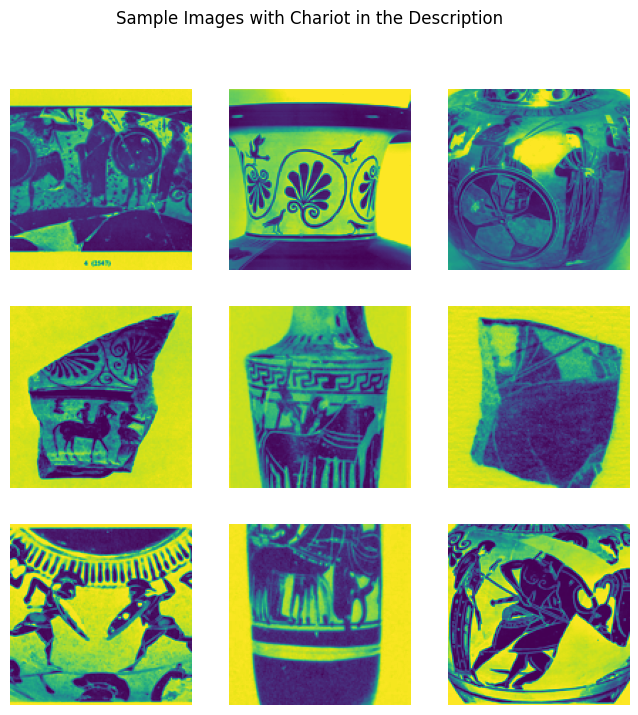

In [ ]:
# Let's now look at some chariot images

fig, axs = plt.subplots(3,3,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Sample Images with Chariot in the Description")
for i,ax in enumerate(axs.flat):
    ax.imshow(clean_images[np.random.choice(char_idx, replace = False)])
    ax.axis('off')

plt.show()

### Distributions and histograms

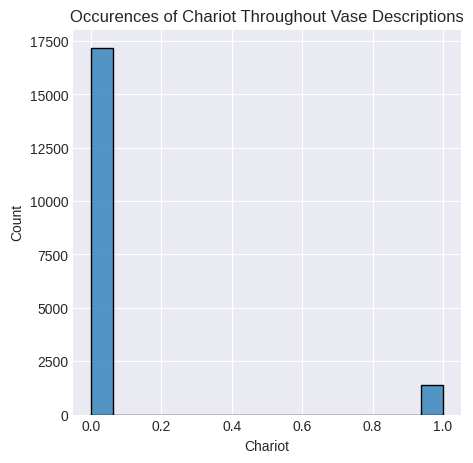

In [ ]:
# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))

sns.histplot(x='Chariot', data=new_df)
ax.set_title("Occurences of Chariot Throughout Vase Descriptions",axes=ax)

plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: The default value of regex will change from True to False in a future version.
  after removing the cwd from sys.path.


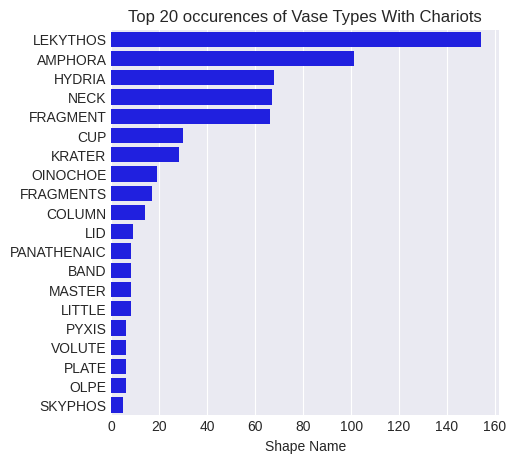

In [ ]:
# Get all counts for vase types
char_df = new_df.iloc[char_idx,:] 
#char_df = new_df[new_df[Unnamed: 0][char_idx,:]
counts = char_df['Shape Name'].str.replace(r'[():,.!?\\-]', '')
counts = counts.str.split().explode().value_counts()

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['A', 'B']

# Get top20 counts
cond = counts.index.isin(stoppage_words)
counts = counts[~cond].sort_values(ascending=False)[:20]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 20 occurences of Vase Types With Chariots")
sns.barplot(y=counts.index, x=counts, axes=ax, color = "blue")

plt.show()

del counts

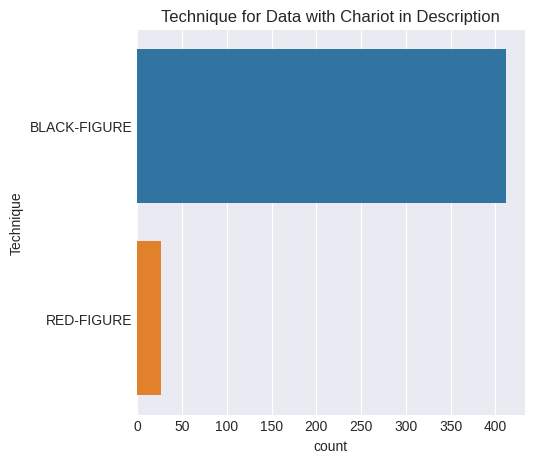

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Technique", data=char_df)
ax.set_title("Technique for Data with Chariot in Description")
#ax.set_xticklabels(ax.get_xticklabels(), rotation = 30, axes=ax)
plt.show()

[]

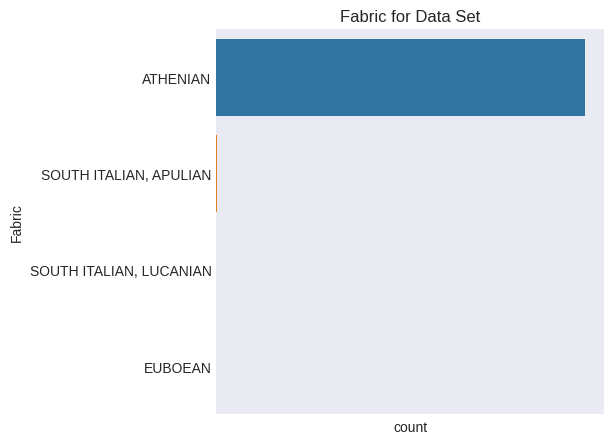

In [ ]:
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
sns.countplot(y="Fabric", data= new_df, axes=ax)
ax.set_title("Fabric for Data Set")
ax.set_xticks([])

## Shield exploratory data analysis

### Image samples

In [ ]:
shi_idx = get_cat_ex_idx(new_df, 'Shield')

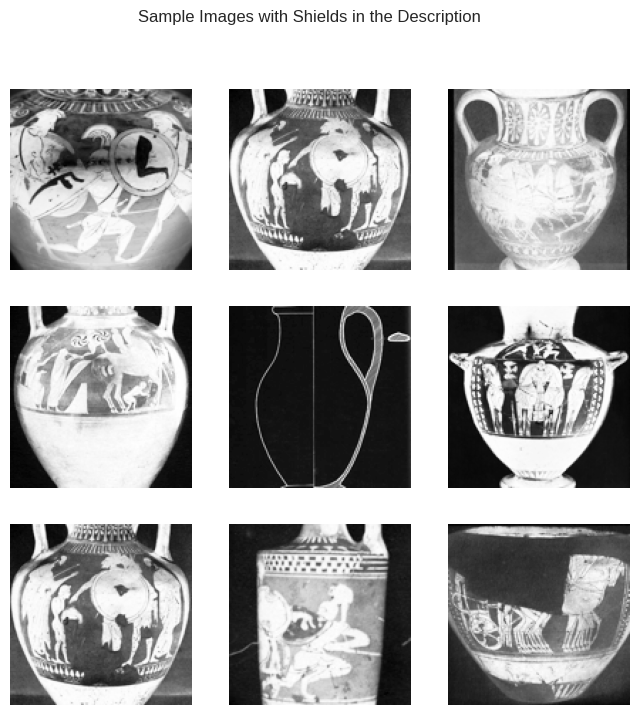

In [ ]:
# Let's now look at some shields images

fig, axs = plt.subplots(3,3,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Sample Images with Shields in the Description")
for i,ax in enumerate(axs.flat):
    ax.imshow(clean_images[np.random.choice(shi_idx, replace = False)])
    ax.axis('off')

plt.show()

### Distributions and histograms

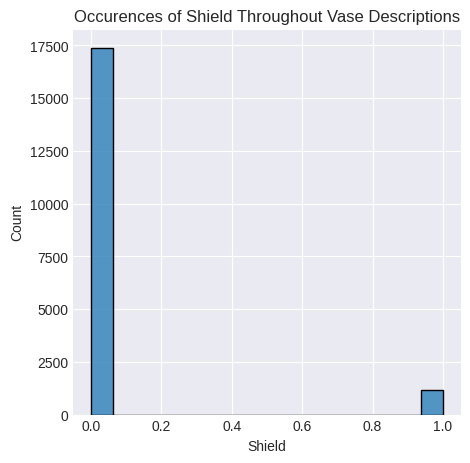

In [ ]:
# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))

sns.histplot(x='Shield', data=new_df)
ax.set_title("Occurences of Shield Throughout Vase Descriptions",axes=ax)

plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: The default value of regex will change from True to False in a future version.
  after removing the cwd from sys.path.


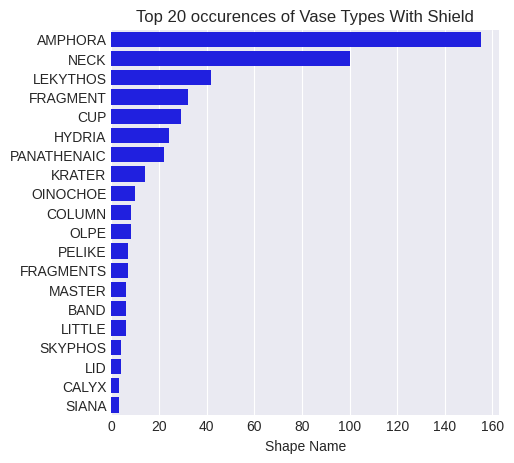

In [ ]:
# Get all counts for vase types
shi_df = new_df.iloc[shi_idx,:] 
#char_df = new_df[new_df[Unnamed: 0][char_idx,:]
counts = shi_df['Shape Name'].str.replace(r'[():,.!?\\-]', '')
counts = counts.str.split().explode().value_counts()

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['A', 'B']

# Get top20 counts
cond = counts.index.isin(stoppage_words)
counts = counts[~cond].sort_values(ascending=False)[:20]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 20 occurences of Vase Types With Shield")
sns.barplot(y=counts.index, x=counts, axes=ax, color = "blue")

plt.show()

del counts

## Satyr exploratory analysis

### Image samples

In [ ]:
sat_idx = get_cat_ex_idx(new_df, 'Satyr')

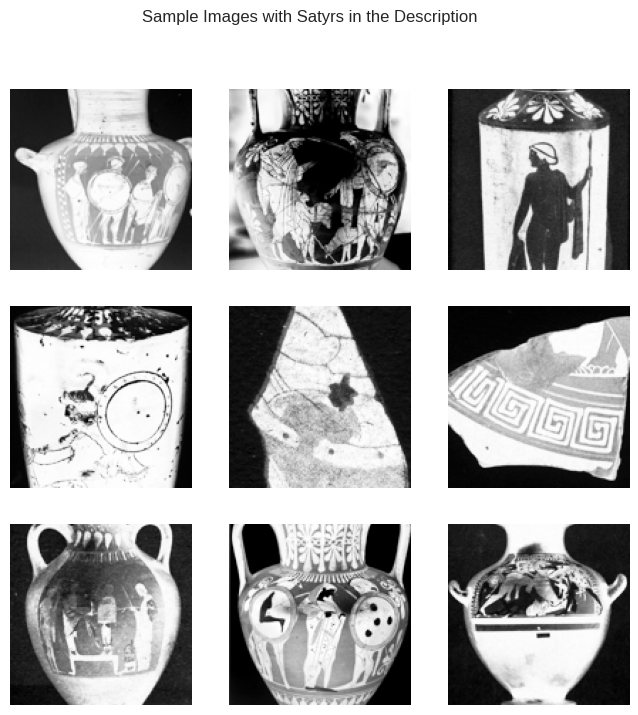

In [ ]:
# Let's now look at some shields images

fig, axs = plt.subplots(3,3,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Sample Images with Satyrs in the Description")
for i,ax in enumerate(axs.flat):
    ax.imshow(clean_images[np.random.choice(shi_idx, replace = False)])
    ax.axis('off')

plt.show()

### Distribution and histograms

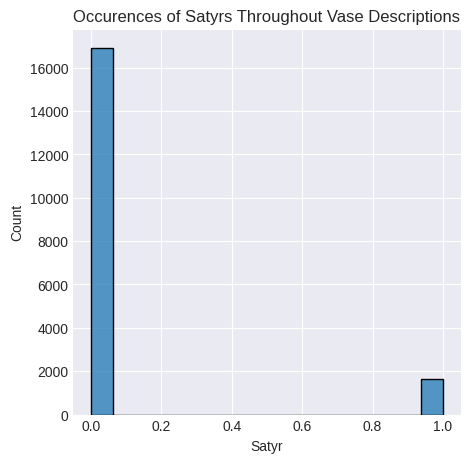

In [ ]:
# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))

sns.histplot(x='Satyr', data=new_df)
ax.set_title("Occurences of Satyrs Throughout Vase Descriptions",axes=ax)

plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: The default value of regex will change from True to False in a future version.
  after removing the cwd from sys.path.


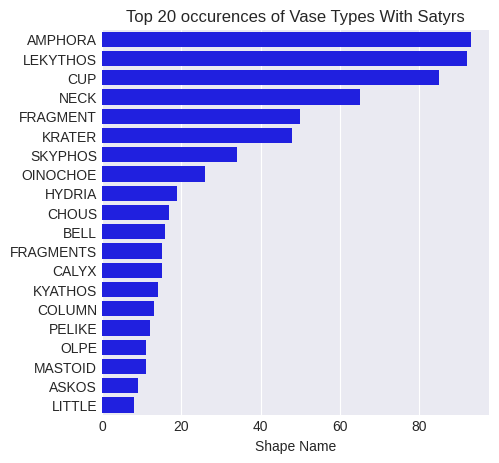

In [ ]:
# Get all counts for vase types
sat_df = new_df.iloc[sat_idx,:] 
#char_df = new_df[new_df[Unnamed: 0][char_idx,:]
counts = sat_df['Shape Name'].str.replace(r'[():,.!?\\-]', '')
counts = counts.str.split().explode().value_counts()

# Get rid of irrelevant words like articles, punctuation, etc.
stoppage_words = ['A', 'B']

# Get top20 counts
cond = counts.index.isin(stoppage_words)
counts = counts[~cond].sort_values(ascending=False)[:20]

# Plot
plt.style.use('seaborn-darkgrid')# Plot
fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.set_title("Top 20 occurences of Vase Types With Satyrs")
sns.barplot(y=counts.index, x=counts, axes=ax, color = "blue")

plt.show()

del counts

# Methods and Models

## Feature engineering

### Train and testing dataset building

Since we are dealing with three different objects that have different frequencies, we create three different balanced datasets for each object. While building our datasets, we first consider the number of vases that cotain images of each object and make sure we only grab the same number of vases without the object.

We then split each dataset into a train and validation data, taking into account that we have multiple images for some vases. Since we do not want a slightly different image of the same vase to appear in both the train and test set, we take care of this by train and test splitting by vase. We use 20 percent of images for the validation set that we use for training.

For the test set, we load in a third batch of data (10,000 images) and count the number of vases with the objects and grab the same number of vases without the object. All of this is done when we want to evaluate the performance of our model in the subsection "Performance in Unseen Data."

In [ ]:
from pandas.core.common import cast_scalar_indexer
import tensorflow as tf

resize_size = 128

def balanced_split(df, images, cat, split=0.7, shapes=True):
  
  # get ids for some cat(ex. chariots) images
  cat_ids = df["id"][df[cat]==1].unique()
  # get ids for same number of non-cat(ex. shields) images
  noncat_ids = df["id"][df[cat]==0].unique()[:len(cat_ids)]
  # combine into list of unique ids
  unique_ids = [*cat_ids, *noncat_ids]

  # Get X, y arrays
  X = images.reshape(-1, resize_size, resize_size, 1)
  y = df[cat].values.astype('float32')

  # Balance dataset
  train_idxs = np.random.choice(unique_ids, replace=False,
                                size=int(split*len(unique_ids)), )
  test_idxs = [num for num in unique_ids if num not in train_idxs]

  # Get train and test data
  X_train = tf.convert_to_tensor(X[df['id'].isin(train_idxs)])
  y_train = tf.convert_to_tensor(y[df['id'].isin(train_idxs)])
  X_test = tf.convert_to_tensor(X[df['id'].isin(test_idxs)])
  y_test = tf.convert_to_tensor(y[df['id'].isin(test_idxs)])

  if shapes:
    print('----------------------------------------')
    print(f'Category: {cat}')
    print(f'Size of train_X: {X_train.shape}')
    print(f'Size of test_X: {X_test.shape}')
    print(f'Size of train_y: {y_train.shape}')
    print(f'Size of test_y: {y_test.shape}')

  # Create dataset
  train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
  test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))

  return (train_dataset, test_dataset)


def shuffle_batch(dataset1, dataset2, batch_size=256):

  dataset1 = dataset1.shuffle(1000)
  dataset1 = dataset1.batch(batch_size)
  dataset2 = dataset2.shuffle(1000)
  dataset2 = dataset2.batch(batch_size)

  return dataset1, dataset2

In [ ]:
(train_data_shi, test_data_shi) = balanced_split(new_df, clean_images, 'Shield')
(train_data_shi, test_data_shi) = shuffle_batch(train_data_shi, test_data_shi)

(train_data_char, test_data_char) = balanced_split(new_df, clean_images, 'Chariot')
(train_data_char, test_data_char) = shuffle_batch(train_data_char, test_data_char)

(train_data_sat, test_data_sat) = balanced_split(new_df, clean_images, 'Satyr')
(train_data_sat, test_data_sat) = shuffle_batch(train_data_sat, test_data_sat)

----------------------------------------
Category: Shield
Size of train_X: (1614, 128, 128, 1)
Size of test_X: (696, 128, 128, 1)
Size of train_y: (1614,)
Size of test_y: (696,)
----------------------------------------
Category: Chariot
Size of train_X: (2009, 128, 128, 1)
Size of test_X: (942, 128, 128, 1)
Size of train_y: (2009,)
Size of test_y: (942,)
----------------------------------------
Category: Satyr
Size of train_X: (2313, 128, 128, 1)
Size of test_X: (1045, 128, 128, 1)
Size of train_y: (2313,)
Size of test_y: (1045,)


In [ ]:
# Augmenting the train data

#train_data_shi2 = augment(train_data_shi)

### Data augmentation

We decided to try data augmentation to improve the performance of our models. However, they did little improvement to the point that the difference was marginal. Since augmenting data involved more dataset, we decided to only report the models trained without data augmentation. In addition, since we use convolutional neural networks, the impact of using data augmentation is more limited than in other cases we saw in class.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import convolve2d, correlate2d
from sklearn.datasets import load_sample_image
import tensorflow as tf
!pip install tensorflow-addons
import tensorflow_addons as tfa
import tensorflow_datasets as tfds
import os
import random as rn
from PIL import Image

H = W = 128

def random_rotate(image, label):
    """Dataset pipe that rotates an image, helper function to augment below"""
    shape = image.shape
    deg = tf.random.uniform([],-10.,10.)
    image = tfa.image.rotate(image, deg/180.*np.pi, interpolation="BILINEAR")
    image.set_shape((shape))
    #label.set_shape(())
    return image, label

def random_zoom(image, label):
    """Dataset pipe that zooms an image, helper function to augment below"""
    shape = image.shape
    rand_float = tf.random.uniform([],10,20)
    rand_int = tf.cast(rand_float, tf.int32)
    image = tf.image.resize_with_crop_or_pad(image,
                                             H + H//rand_int,
                                             W + W//rand_int)
    image = tf.image.random_crop(image, size=[H, W, 1])
    return image, label

def random_flip(image, label):
    
    image = tf.image.random_flip_left_right(image)
    return image, label

def random_contrast(image, label):

    image = tf.image.random_contrast(image, lower=.95, upper=1.)
    return image, label
    
# Do augment(dataset) before batching
def augment(dataset, rotate=True, zoom=True, 
            flip=True, contrast=True, 
            display_first=True):
    """Function that randomly alters an image with
       flipping, rotation, zoom, and contrast adjustment"""
    
    if flip:
      dataset = dataset.map(random_flip)
    if rotate:
      dataset = dataset.map(random_rotate)
    if zoom:
      dataset = dataset.map(random_zoom)
    if contrast:
      dataset = dataset.map(random_contrast)
    if display_first:
      plt.imshow(next(iter(dataset))[0][0][:,:,0])
    
    return dataset

     |████████████████████████████████| 1.1 MB 9.7 MB/s 


## Model building

Before we run the different models, it is worth discussing one possible source of noise in our model and that could limit the amount that our model can learn and how it might perform. The descriptions that we have are unique to each vase. However, if a vase has a chariot then there is no guarantee that all images will have the chariot. Say it is only on one side, then if you have pictures of the vase from four sides, a chariot might appear only on one side but our column will say that all four images contain a chariot since the vase has at least one chariot. If a vase has only one image, then it is clear that the description will contain the object. All vases have many images and there is already a low enough number of vases with the objects, so it would be impossible to limit the sample to vases that only have one image. Before running the models, it was unclear how much this might limit our models (i.e., do most images for a vase contain the object or does only a minority?), but it turns out that it might play a big role in training and validation accuracy.

Since we are dealing with images, we use convolutional neural networks to try to model our outcomes of interest. As mentioned previously, we will fit models to different outcomes rather than trying to solve a multiclassification problem since many objects appear together in vases. The three outcomes that we try to model pose a range in terms of what we believe the networks might find easier and more difficult to identify. For example, a chariot is composed of many parts and has a specific context which might make it easier for models to identify. In contrast, objects like shields might be confused with other round objects or satyrs with humans. We wanted to evaluate different types of models for a range of objects as this provides a more complete picture of how useful different models might be beyond this project.

Below, we define the graphing function that we use to evaluate model. We graph both loss and accuracy across epochs for the given history of the model since both of these measures gives us insights into how our model is working.



In [ ]:
#### GRAPHING FUNCTION

def plot_history(hist, title=None, ax=None):
    fig, axs = plt.subplots(1,2, figsize=(16, 5))
    axs[0].plot(hist.history['accuracy'], c='r',label='train')
    axs[0].plot(hist.history['val_accuracy'],color ="blue", label='validation')
    axs[0].set_xlabel('epoch')
    axs[0].set_ylabel('accuracy')
    axs[0].legend()
    axs[0].set_title(f"Accuracy for {title}")
    axs[0].grid(":", alpha = 0.4)
    axs[1].plot(hist.history['loss'],c='r', label='train')
    axs[1].plot(hist.history['val_loss'],color ="blue", label='validation')
    axs[1].set_xlabel('epoch')
    axs[1].set_ylabel('binary_crossentropy')
    axs[1].legend()
    axs[1].set_title(f"Loss for {title}")
    axs[1].grid(":", alpha = 0.4)

In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models

### Baseline Model

Our baseline model consists of two convolutional layers with a maxpool layer between them, a dense layer and an output layer. This is a relatively simple model that we use to evaluate how a first model performs.

As expected this model is the one that performs the worst, by a substantial margin. As we have discussed before, we expect our models to perform poorly because of the nature of the dataset. However, this model underperforms all the model approaches we tried. This is because our model is very basic. It inclused a small number of convolutional and maxpooling layers, with not enough filters. In addition, we do not use batch normalization and dropout (for the sense layers) that are known to substantially improve the performance of models. While the difference between the baseline and the model is noticeable, it is not huge. If our data were perfect, we would expect this difference in performance to be much larger.

In [ ]:
#############################
## BASELINE
#############################

resize_size = 128

baseline = models.Sequential()
baseline.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
baseline.add(layers.MaxPooling2D((2, 2)))
baseline.add(layers.Conv2D(64, (3, 3), activation='relu'))
baseline.add(layers.Flatten())
baseline.add(layers.Dense(64, activation='relu'))
baseline.add(layers.Dense(1, activation='sigmoid'))

display(baseline.summary())


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 63, 63, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 flatten (Flatten)           (None, 238144)            0         
                                                                 
 dense (Dense)               (None, 64)                15241280  
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                        

None

For the shield and the satyr model, the learning seems to be limited: the validation accuracy is at 50 percent during most of our training. The low validation accuracy is not even due to overfitting; the training accuracy is just as bad. The only model that seems to be learning some useful information is the shield model. After the first ten epochs, the shield training model starts to overfit with the validation accuracy not further improving. This is probably due to the fact that the model is not able to learn much from this simpler model, thus in the next models we will increase the complexity and also try model architectures that are known to be good for classification.

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 flatten_1 (Flatten)         (None, 238144)            0         
                                                                 
 dense_2 (Dense)             (None, 64)                15241280  
                                                                 
 dense_3 (Dense)             (None, 1)                 65        
                                                      

None

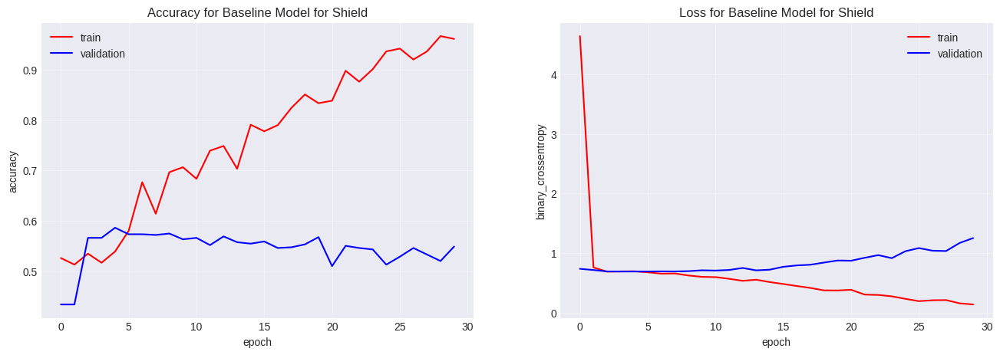

In [ ]:
#############################
## BASELINE SHIELD
#############################

resize_size = 128

baseline_sh = models.Sequential()
baseline_sh.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
baseline_sh.add(layers.MaxPooling2D((2, 2)))
baseline_sh.add(layers.Conv2D(64, (3, 3), activation='relu'))
baseline_sh.add(layers.Flatten())
baseline_sh.add(layers.Dense(64, activation='relu'))
baseline_sh.add(layers.Dense(1, activation='sigmoid'))

display(baseline_sh.summary())

# Shield
baseline_sh.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_shi_baseline = baseline_sh.fit(train_data_shi, epochs=30, verbose=0,
                                    validation_data=test_data_shi)

plot_history(history_shi_baseline, title = "Baseline Model for Shield")

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 flatten_2 (Flatten)         (None, 238144)            0         
                                                                 
 dense_4 (Dense)             (None, 64)                15241280  
                                                                 
 dense_5 (Dense)             (None, 1)                 65        
                                                      

None

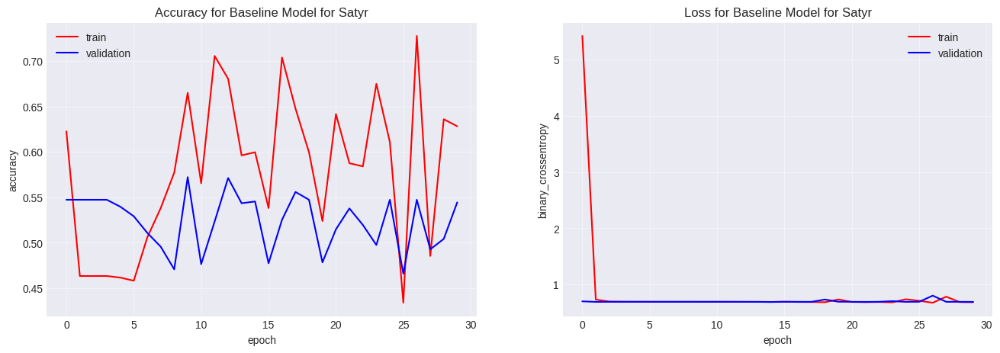

In [ ]:
#############################
## BASELINE Satyr
#############################

resize_size = 128

baseline_sa = models.Sequential()
baseline_sa.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
baseline_sa.add(layers.MaxPooling2D((2, 2)))
baseline_sa.add(layers.Conv2D(64, (3, 3), activation='relu'))
baseline_sa.add(layers.Flatten())
baseline_sa.add(layers.Dense(64, activation='relu'))
baseline_sa.add(layers.Dense(1, activation='sigmoid'))

display(baseline_sa.summary())
baseline_sa.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_sat_baseline = baseline_sa.fit(train_data_sat, epochs=30, verbose=0,
                                    validation_data=test_data_sat)

plot_history(history_sat_baseline , title = "Baseline Model for Satyr")

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 flatten_3 (Flatten)         (None, 238144)            0         
                                                                 
 dense_6 (Dense)             (None, 64)                15241280  
                                                                 
 dense_7 (Dense)             (None, 1)                 65        
                                                      

None

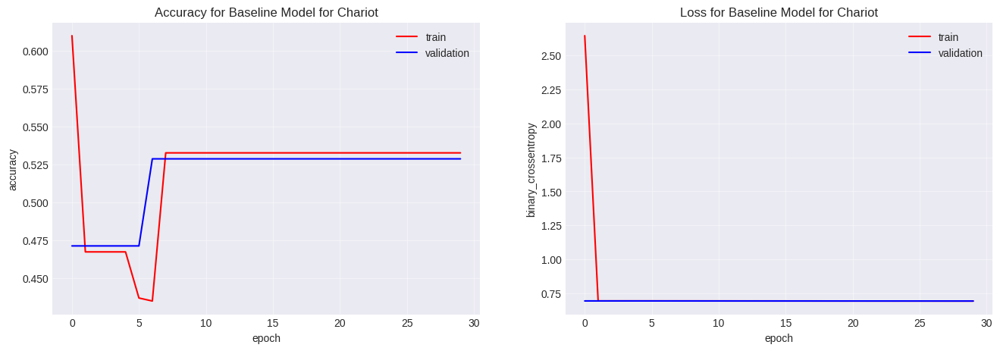

In [ ]:
#############################
## BASELINE Chariot
#############################

resize_size = 128

baseline_ch = models.Sequential()
baseline_ch.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
baseline_ch.add(layers.MaxPooling2D((2, 2)))
baseline_ch.add(layers.Conv2D(64, (3, 3), activation='relu'))
baseline_ch.add(layers.Flatten())
baseline_ch.add(layers.Dense(64, activation='relu'))
baseline_ch.add(layers.Dense(1, activation='sigmoid'))

display(baseline_ch.summary())
baseline_ch.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_char_baseline  = baseline_ch.fit(train_data_char, epochs=30, verbose=0, 
                                      validation_data=test_data_char)

plot_history(history_char_baseline, title = "Baseline Model for Chariot")

### Model 1: Adding more convolutional and maxpool layers

The next model we try is one where we added more Convolutional layers and more MaxPooling layers, adding complexity to the models and allowing them to pick up on more shapes that we see in the vases. The neural networks seem to be learning information compared to the baseline, even if we do overfit at times. 

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_9 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 14, 14, 64)      

None

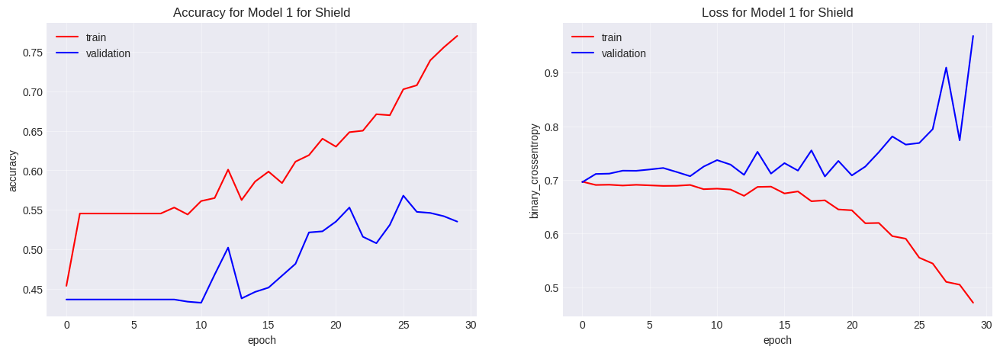

In [ ]:
#############################
## MODEL 1  Shield
#############################

model1_sh = models.Sequential()
model1_sh.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
model1_sh.add(layers.MaxPooling2D((2, 2)))
model1_sh.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sh.add(layers.MaxPooling2D((2, 2)))
model1_sh.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sh.add(layers.MaxPooling2D((2, 2)))
model1_sh.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sh.add(layers.MaxPooling2D((2, 2)))
model1_sh.add(layers.Conv2D(64, (4, 4), activation='relu'))
model1_sh.add(layers.Flatten())
model1_sh.add(layers.Dense(64, activation='relu'))
model1_sh.add(layers.Dense(1, activation='sigmoid'))

display(model1_sh.summary())

model1_sh.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_shi_model1 = model1_sh.fit(train_data_shi, epochs=30, verbose=0,
                    validation_data=test_data_shi)

plot_history(history_shi_model1, title = "Model 1 for Shield")

For the Shield model we see that our accuracy reaches around 60 oercent around epoch 15 and oscillates between 55 percent and 60 percent for the remaining periods. Our training accuracy continues to increase, but this is likely due to noise.

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 14, 14, 64)      

None

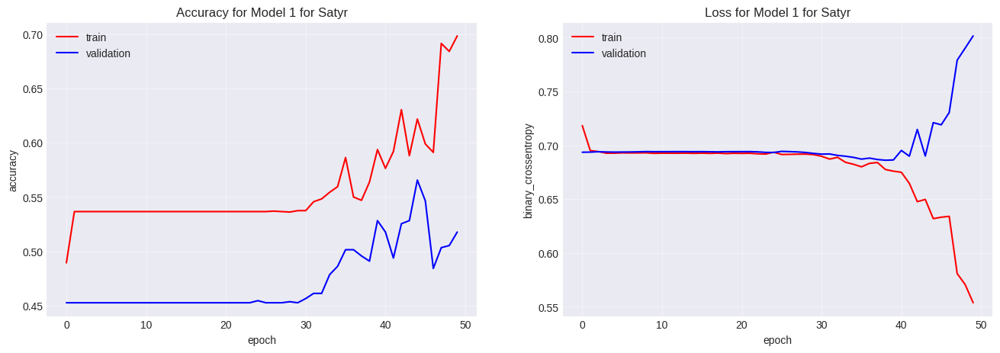

In [ ]:
#############################
## MODEL 1  Satyr
#############################

model1_sa = models.Sequential()
model1_sa.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
model1_sa.add(layers.MaxPooling2D((2, 2)))
model1_sa.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sa.add(layers.MaxPooling2D((2, 2)))
model1_sa.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sa.add(layers.MaxPooling2D((2, 2)))
model1_sa.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_sa.add(layers.MaxPooling2D((2, 2)))
model1_sa.add(layers.Conv2D(64, (4, 4), activation='relu'))
model1_sa.add(layers.Flatten())
model1_sa.add(layers.Dense(64, activation='relu'))
model1_sa.add(layers.Dense(1, activation='sigmoid'))

display(model1_sa.summary())
model1_sa.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_sat_model1 = model1_sa.fit(train_data_sat, epochs=50, verbose=0,
                    validation_data=test_data_sat)

plot_history(history_sat_model1, title = "Model 1 for Satyr")

The model for satyr is still not able to learn a lot of information. While the model is not stuck as it was before, the acuracy is stuck below 60 percent. Even if it is better than the baseline, this model would not be useful in real life.

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 63, 63, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_19 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 30, 30, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_20 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 14, 14, 64)      

None

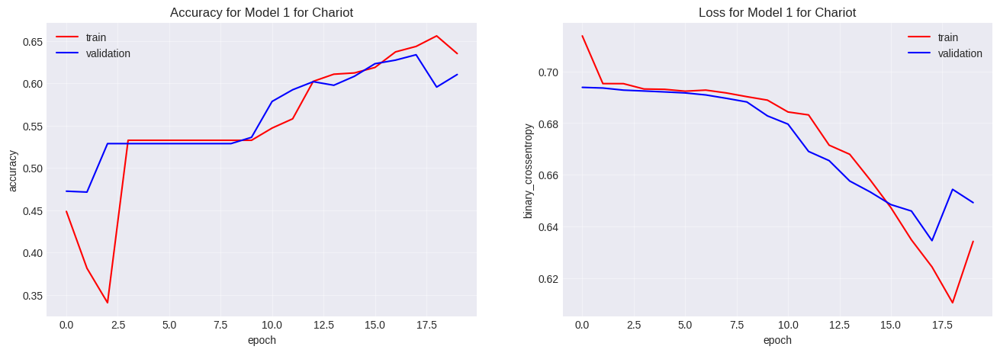

In [ ]:
#############################
## MODEL 1  Chariot
#############################

model1_ch = models.Sequential()
model1_ch.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
model1_ch.add(layers.MaxPooling2D((2, 2)))
model1_ch.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_ch.add(layers.MaxPooling2D((2, 2)))
model1_ch.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_ch.add(layers.MaxPooling2D((2, 2)))
model1_ch.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1_ch.add(layers.MaxPooling2D((2, 2)))
model1_ch.add(layers.Conv2D(64, (4, 4), activation='relu'))
model1_ch.add(layers.Flatten())
model1_ch.add(layers.Dense(64, activation='relu'))
model1_ch.add(layers.Dense(1, activation='sigmoid'))

display(model1_ch.summary())
model1_ch.compile(optimizer=tf.keras.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_char_model1 = model1_ch.fit(train_data_char, epochs=20, verbose=0,
                         validation_data=test_data_char)

plot_history(history_char_model1, title = "Model 1 for Chariot")

The model for chariots seems to perform better than the baseline we had previously and starts to achieve better accuracy.

### Model 2: Modified Alexnet

Rather than blindly trying model architectures after fitting our more previous model, we decide to try a known model architecture. While the structure of AlexNet is used for multiclass classification, we decide to change the output layers to one with one node and sigmoid activation and use the architecture to see whether this type of model could be helpful to us. AlexNet uses eight layers: five convolutional layers, some of which are followed by max-pooling layers, and three fully connected layers with dropout layers in between.

From the output, we learn that this type of model might be too complex and leads to overfitting to the train data. While our model is definitely learning information as the train accuracy improves from epoch to epoch, the validation accuracy does not ever improve beyond the low 50 percent for any of the objects and the validation loss for the most only increases. 

In [ ]:
#############################
## Model 2: Modified ALEXNET  
#############################

alexnet_mod = models.Sequential([
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(128,128,1)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

alexnet_mod.summary()


Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_23 (Conv2D)          (None, 30, 30, 96)        11712     
                                                                 
 batch_normalization (BatchN  (None, 30, 30, 96)       384       
 ormalization)                                                   
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 14, 14, 96)       0         
 g2D)                                                            
                                                                 
 conv2d_24 (Conv2D)          (None, 14, 14, 256)       614656    
                                                                 
 batch_normalization_1 (Batc  (None, 14, 14, 256)      1024      
 hNormalization)                                                 
                                                      

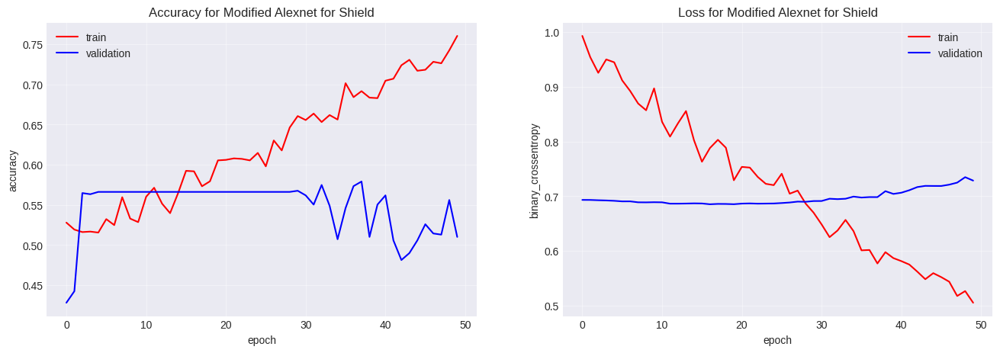

In [ ]:
# Shield
alexnet_mod_sh = models.Sequential([
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(128,128,1)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

alexnet_mod_sh.compile(loss='binary_crossentropy', 
              optimizer=tf.optimizers.SGD(learning_rate=0.001), 
              metrics=['accuracy'])

history_shi_alex = alexnet_mod_sh.fit(train_data_shi, epochs=50, verbose=0,
                                   validation_data=test_data_shi)

plot_history(history_shi_alex, title = "Modified Alexnet for Shield")

The model seems to be overly complex and we overfit from the beginning. While the training accuracy continuously increases, the validation accuracy is well below 50 percent during the 50 epochs.

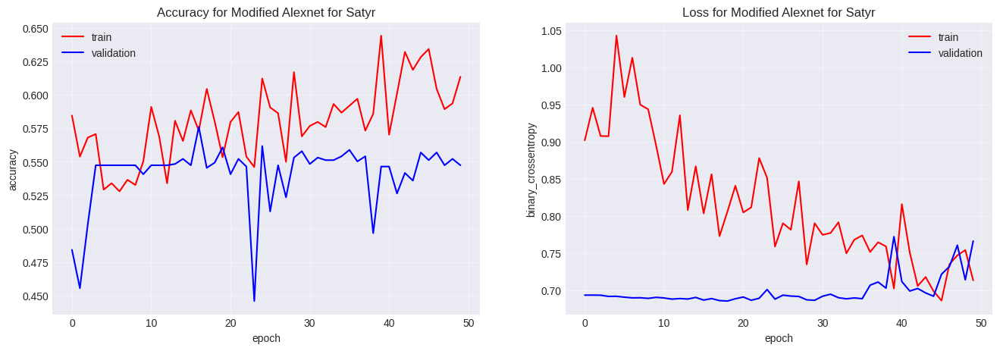

In [ ]:
# Satyr
alexnet_mod_sa = models.Sequential([
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(128,128,1)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

alexnet_mod_sa.compile(loss='binary_crossentropy', 
              optimizer=tf.optimizers.SGD(learning_rate=0.001), 
              metrics=['accuracy'])

history_sat_alex = alexnet_mod_sa.fit(train_data_sat, epochs=50, verbose=0,
                                   validation_data=test_data_sat)

plot_history(history_sat_alex, title = "Modified Alexnet for Satyr")

For the Satyr model, we also perform worse than our model 1 and seem to be overfitting to the data from the beginning.

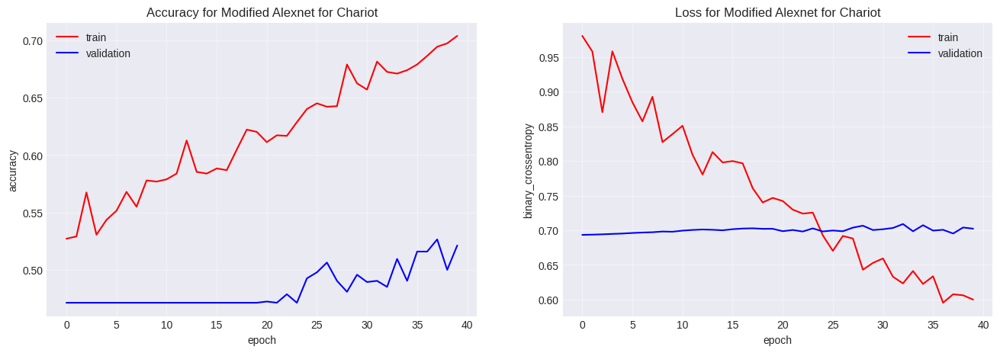

In [ ]:
# Chariot
alexnet_mod_ch = models.Sequential([
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(128,128,1)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4096, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

alexnet_mod_ch.compile(loss='binary_crossentropy', 
              optimizer=tf.optimizers.SGD(learning_rate=0.001), 
              metrics=['accuracy'])

history_char_alex = alexnet_mod_ch.fit(train_data_char, epochs=40, verbose=0,
                         validation_data=test_data_char)

plot_history(history_char_alex, title = "Modified Alexnet for Chariot")

For the chariot model, we also seem to be overfitting to the data since the training accuracy is well above the validation accuracy. The validation accuracy seems to be stuck below 50 percent once again.

### Model 3: Fitting more unique models for each of the outcomes

 We can notice that for this for each of the outcomes, the graphs show different trajectories in training that go beyond needing to train for a different number of epochs. The way we approach the construction of these models consisted in trying different models and seeing which changes were more effective than others.

In terms of overfitting, our models for shields and chariot seem to be overfitting to the train data. However, this varies from iteration to iteration and the train and test split that we end up with. Since the validation accuracy remains relatively stable for the number of epochs chosen but it is not for lower number of epochs we decide to train for longer but are aware that this might lead to problems when we look at new data. 

The model that was most difficult to fit was the one for satyrs. Achieivng accuracy above 50 percent proved very difficult and it is only throgh trying a lot of different alternatives that we managed to reach 55 percent in the model before it started to overfit. However, the accuracy varies wildly. Trying different optimizers, learning rates and dropout rates did not help much with this problem since they brought the accuracy down most times.

Below we print out the architecture of the final models and the train and validation accuracy and loss for our models. Our final models for each of the objects approach 60 percent accuracy. While this is not an ideal accuracy, our model is definitely learning from the data it has. Trying different number of epochs,  optimizers, number of convolutional/max pooling layers and number of nodes in the dense layers and dropout rates between them to limit overfitting, did not help improve the accuracy or the loss. The models that we end up with are more complex and have more parameters than model 1 but are less complex than the modified alexnet. We discuss why this might be the case when we look at incorrectly classified images and saliency maps in the next sections.


Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_43 (Conv2D)          (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_28 (MaxPoolin  (None, 63, 63, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_44 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_29 (MaxPoolin  (None, 30, 30, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_45 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 max_pooling2d_30 (MaxPoolin  (None, 14, 14, 64)     

None

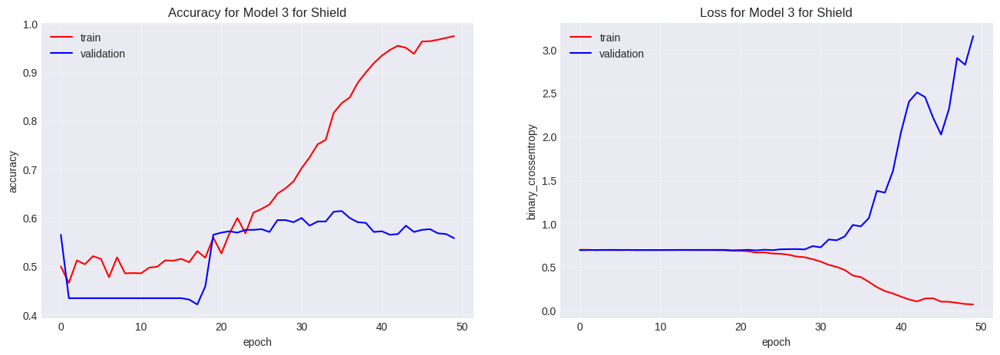

In [ ]:
#############################
## Model 3 - SHIELD
#############################

model3a = models.Sequential()
model3a.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
model3a.add(layers.MaxPooling2D((2, 2)))
model3a.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3a.add(layers.MaxPooling2D((2, 2)))
model3a.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3a.add(layers.MaxPooling2D((2, 2)))
model3a.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3a.add(layers.MaxPooling2D((2, 2)))
model3a.add(layers.Conv2D(64, (4, 4), activation='relu'))
model3a.add(layers.Flatten())
model3a.add(layers.Dense(128, activation='relu')) # used to be 128 on both and 0.5 for dropout
model3a.add(layers.Dropout(0.45))
model3a.add(layers.Dense(128, activation='relu'))
model3a.add(layers.Dropout(0.45))
model3a.add(layers.Dense(1, activation='sigmoid'))

display(model3a.summary())

model3a.compile(optimizer=tf.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_shi_model3 = model3a.fit(train_data_shi, epochs=50, verbose=0,
                                    validation_data=test_data_shi)

plot_history(history_shi_model3, title = "Model 3 for Shield")

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_48 (Conv2D)          (None, 30, 30, 96)        11712     
                                                                 
 batch_normalization_20 (Bat  (None, 30, 30, 96)       384       
 chNormalization)                                                
                                                                 
 max_pooling2d_32 (MaxPoolin  (None, 14, 14, 96)       0         
 g2D)                                                            
                                                                 
 conv2d_49 (Conv2D)          (None, 14, 14, 256)       614656    
                                                                 
 batch_normalization_21 (Bat  (None, 14, 14, 256)      1024      
 chNormalization)                                                
                                                     

None

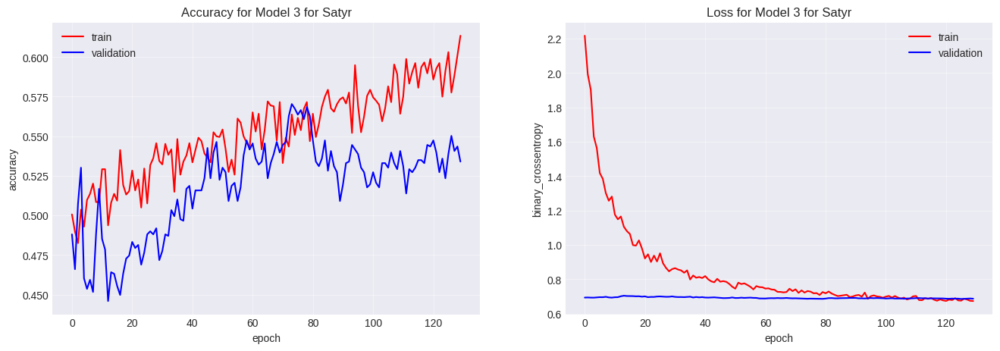

In [ ]:
#############################
## Model 3 - SATYR
#############################

model3b =  models.Sequential([
    layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(128,128,1)),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.55),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.75),
    layers.Dense(1, activation='sigmoid')
])

display(model3b.summary())

model3b.compile(optimizer=tf.optimizers.SGD(learning_rate=0.001),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_sat_model3 = model3b.fit(train_data_sat, epochs=130, verbose=0,
                                    validation_data=test_data_sat)

plot_history(history_sat_model3, title = "Model 3 for Satyr")

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_53 (Conv2D)          (None, 126, 126, 32)      320       
                                                                 
 max_pooling2d_35 (MaxPoolin  (None, 63, 63, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_54 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_36 (MaxPoolin  (None, 30, 30, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_55 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 max_pooling2d_37 (MaxPoolin  (None, 14, 14, 64)     

None

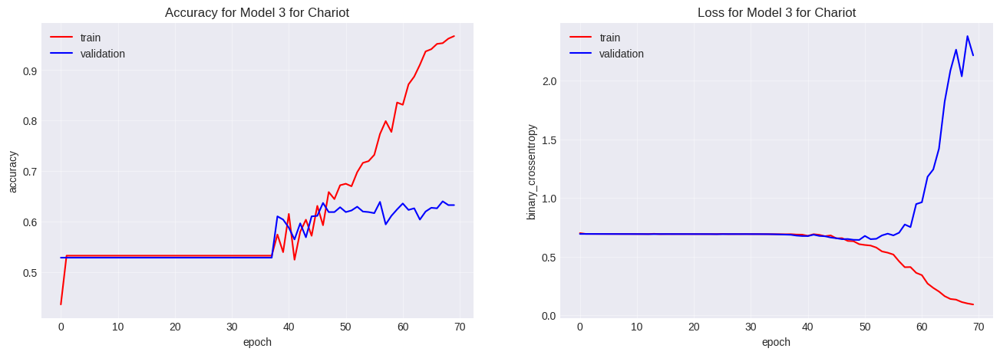

In [ ]:
#############################
## Model 3 - CHARIOT
#############################


model3c =  models.Sequential()
model3c.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 1)))
model3c.add(layers.MaxPooling2D((2, 2)))
model3c.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3c.add(layers.MaxPooling2D((2, 2)))
model3c.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3c.add(layers.MaxPooling2D((2, 2)))
model3c.add(layers.Conv2D(64, (3, 3), activation='relu'))
model3c.add(layers.MaxPooling2D((2, 2)))
model3c.add(layers.Conv2D(64, (4, 4), activation='relu'))
model3c.add(layers.Flatten())
model3c.add(layers.Dense(512, activation='relu'))
model3a.add(layers.Dropout(0.4))
model3c.add(layers.Dense(64, activation='relu'))
model3a.add(layers.Dropout(0.45))
model3c.add(layers.Dense(64, activation='relu'))
model3c.add(layers.Dense(1, activation='sigmoid'))


display(model3c.summary())

model3c.compile(optimizer=tf.optimizers.Adam(),
              loss='binary_crossentropy',
              metrics=['accuracy'])

history_char_model3  = model3c.fit(train_data_char, epochs=70, verbose=0, 
                                      validation_data=test_data_char)

plot_history(history_char_model3, title = "Model 3 for Chariot")

## Predictions and saliency maps

From the saliency maps, we can learn that our models are definitely looking at the images in the vases and the fragments and picking up shapes to make their decisions. This supports the idea that the lower accuracy in our models is related to the structure of the data rather than the model not being complex enough in its nature. Our models are paying attention to the right things, it might just get confused when its learning by getting inputs that are not vases. We can see that even though it is incorrectly classified in the validation set, the part of the image that the model is looking at sometimes does not have the object. This makes some of our incorrect predictions actually correct. 

While we originally had code that display both incorrectly and correctly classified images, we decide to comment out the correctly classified code to limit the output since correctly classified images are also explored using saliency maps in  the next section. Thus, we display misclassified images to get a first look at what might be confusing our model and then use saliency maps to explore why the models seem to be making the wrong decisions.

### Displaying misclassified vases

The images below display a pattern that is a mix of images that are truly incorrectly classified and some that are incorrectly classified because the description of the vase has the word but where the image itself might not have the object. These is the case sometimes when we predict y=0, but y=1.

In terms of what seems to be confusing our models at this point: it seems like it is different perspectives and outlines. For example, in the shield one there is a man in a circle outline, which our model might interpret as a zoomed in shield. In other cases, the vases might be damaged or photographed badly. In the shield images, we see an image that has a shadow over the corner so that it is not a clear outline, which might confuse our model. 

As expected, satyrs have a more dynamic set of poses that they can appear in just like humans and gods in the vases. The models can also be easily confused by this type of information. Part of the mistakes we seem to make is in this distinction. 

For chariots, we have a mix of mistakes. Mainly it seems to identify collections of geometric shapes as chariots when they are not. It might be the case that it is not learning sufficiently from the rest of the context in the images. The rest of the mistakes seem to be more closely related to images of a vase containing chariots being correctly classified as not having chariots, when they do not have chariots in that specific image, but our model still thinks the the prediction is werong.

#### Shield

In [ ]:
# Obtain incorrectly predicted vases in the first batch
first_batch = next(iter(test_data_shi))
y_pred_test_sh = np.round(model3a.predict(first_batch[0])).flatten()
cond_sh = (first_batch[1]!=y_pred_test_sh)
incorrect_preds_sh = first_batch[0][cond_sh]
true_labs_sh = first_batch[1][cond_sh]

In [ ]:
# Obtain correctly predicted vases in the first batch
y_pred_test_sh = np.round(model3c.predict(first_batch[0])).flatten()
cond_sh = (first_batch[1]==y_pred_test_sh)
correct_preds_sh = first_batch[0][cond_sh]

##### Incorrectly classified

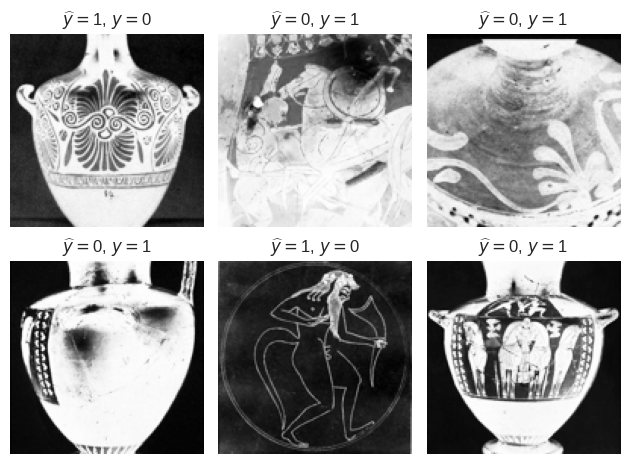

In [ ]:
fig, axs = plt.subplots(2,3, sharex=True,sharey=True)
for i,ax in enumerate(axs.flat):

    resized = tf.reshape(incorrect_preds_sh[i], (resize_size, resize_size))
    ax.imshow(resized)
    ax.set_title('$\widehat{y}=$' + f'{int(1-true_labs_sh[i])}, ' +
                 '$y=$' + f'{int(true_labs_sh[i])}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Code to display correctly classified images

#fig, axs = plt.subplots(2,3, sharex=True,sharey=True)
#for i,ax in enumerate(axs.flat):
#
#    resized = tf.reshape(correct_preds_sh[i], (resize_size, resize_size))
#    ax.imshow(resized)
#    ax.set_title('$\widehat{y}=$' + f'{int(true_labs_sh[i])}, ' +
#                 '$y=$' + f'{int(true_labs_sh[i])}')
#    ax.axis('off')
#
#plt.tight_layout()
#plt.show()

#### Satyr

In [ ]:
# Obtain incorrectly predicted vases in the first batch
first_batch = next(iter(test_data_sat))
y_pred_test_sat = np.round(model3b.predict(first_batch[0])).flatten()
cond_sat = (first_batch[1]!=y_pred_test_sh)
incorrect_preds_sat = first_batch[0][cond_sat]
true_labs_sat = first_batch[1][cond_sat]

In [ ]:
# Obtain correctly predicted vases in the first batch
y_pred_test_sat = np.round(model3c.predict(first_batch[0])).flatten()
cond_sat = (first_batch[1]==y_pred_test_sat)
correct_preds_sat = first_batch[0][cond_sat]

##### Incorrectly classified

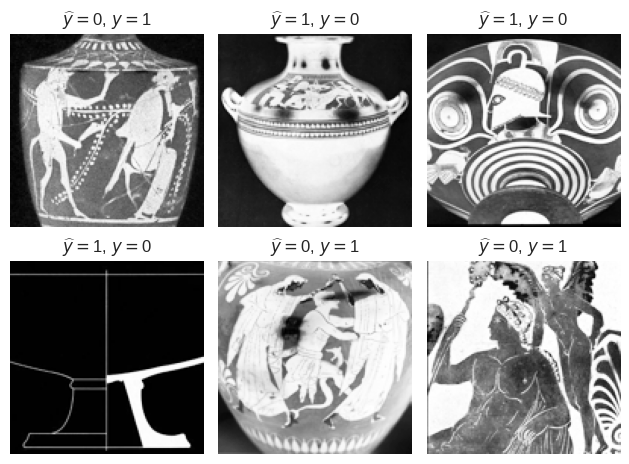

In [ ]:
fig, axs = plt.subplots(2,3, sharex=True,sharey=True)
for i,ax in enumerate(axs.flat):

    resized = tf.reshape(incorrect_preds_sat[i], (resize_size, resize_size))
    ax.imshow(resized)
    ax.set_title('$\widehat{y}=$' + f'{int(1-true_labs_sat[i])}, ' +
                 '$y=$' + f'{int(true_labs_sat[i])}')
    ax.axis('off')


plt.tight_layout()
plt.show()

In [ ]:
# Code to display correctly classified images

#fig, axs = plt.subplots(2,3, sharex=True,sharey=True)
#
#for i,ax in enumerate(axs.flat):
#
#    resized = tf.reshape(correct_preds_sat[i], (resize_size, resize_size))
#    ax.imshow(resized)
#    ax.set_title('$\widehat{y}=$' + f'{int(true_labs_sat[i])}, ' +
#                 '$y=$' + f'{int(true_labs_sat[i])}')
#    ax.axis('off')
#
#plt.tight_layout()
#plt.show()

#### Chariot

In [ ]:
# Obtain incorrectly predicted vases in the first batch
first_batch = next(iter(test_data_char))
y_pred_test_ch = np.round(model3c.predict(first_batch[0])).flatten()
cond_ch = (first_batch[1]!=y_pred_test_ch)
incorrect_preds_ch = first_batch[0][cond_ch]
true_labs_ch = first_batch[1][cond_ch]

In [ ]:
# Obtain correctly predicted vases in the first batch
y_pred_test_ch = np.round(model3c.predict(first_batch[0])).flatten()
cond_ch = (first_batch[1]==y_pred_test_ch)
correct_preds_ch = first_batch[0][cond_ch]

##### Incorrectly classified

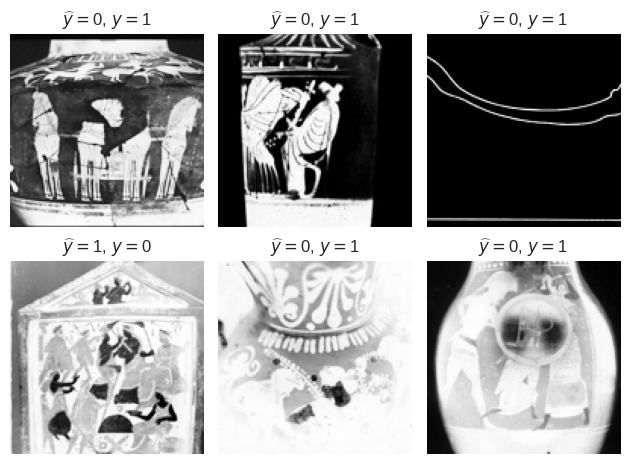

In [ ]:
fig, axs = plt.subplots(2,3, sharex=True,sharey=True)

for i,ax in enumerate(axs.flat):

    resized = tf.reshape(incorrect_preds_ch[i], (resize_size, resize_size))
    ax.imshow(resized)
    ax.set_title('$\widehat{y}=$' + f'{int(1-true_labs_ch[i])}, ' +
                 '$y=$' + f'{int(true_labs_ch[i])}')
    ax.axis('off')


plt.tight_layout()
plt.show()

In [ ]:
# Code to display correctly classified images 
#fig, axs = plt.subplots(2,3, sharex=True,sharey=True)
#
#for i,ax in enumerate(axs.flat):
#
#    resized = tf.reshape(correct_preds_ch[i], (resize_size, resize_size))
#    ax.imshow(resized)
#    ax.set_title('$\widehat{y}=$' + f'{int(true_labs_ch[i])}, ' +
#                 '$y=$' + f'{int(true_labs_ch[i])}')
#    ax.axis('off')
#
#plt.tight_layout()
#plt.show()

Now, we will do some analysis through a GradCam and SmoothGrad

In [ ]:
!pip install tf_keras_vis

### Saliency Maps

We use the saliency to check that the models are learning from the features and drawings on the vase rather than other information. The SmoothGrad map and the Grad-CAM display different information that our model might be picking up. For example, for Gradcam we grab one of the convolutional layers to see what the model is looking at that stage to make sure that it is looking at say a figure in the vase rather than outline since we are trying to get the model to recognize specific objects. For some items, we do seem to be picking up on noise, but for the most part at least one of the two graphs seem to be picking up the importance of an area that we would consider important.


If it is focusing on the figures to make it's decision than the model is on a good track even if the accuracy is not the best because the model is making the decision based on information that we are interested in the model learning. For example, if there are humans in the vase and they model predicts that it is a satyr, then we could develop the model further to try to make it separate humans from beings that are only half human. Based on the types of objects it confuses, we could even consider creating broader categories like "gods, warriors, and satyrs" and "chariots and horses" rather than focusing on only one specific object.

In [ ]:
# Import functions to help
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import BinaryScore
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils import normalize
from matplotlib import cm

In [ ]:
def GCSG(img, true_lab, pred, model_name, k):

  # Create Saliency object.
  saliency = Saliency(model_name,
                      model_modifier=ReplaceToLinear(),
                      clone=True)

  # Create tensor of correct type for image
  tf_img = tf.cast(np.expand_dims(img, axis=0), dtype=tf.float32)

  # Generate saliency map with smoothing that reduce noise by adding noise
  saliency_map = saliency(BinaryScore(true_lab),
                          tf_img,
                          normalize_map=True,
                          smooth_samples=20, # The number of calculating gradients iterations.
                          smooth_noise=0.20) # noise spread level.

  # Create Gradcam object
  gradcam = Gradcam(model_name,
                    model_modifier=ReplaceToLinear(),
                    clone=True)

  # Generate heatmap with GradCAM
  cam = gradcam(BinaryScore(true_lab),
                tf_img,
                penultimate_layer=-k,
                normalize_cam=True) #k needs to change depending on model architecture
  
  fig, axes = plt.subplots(1, 3, figsize=(15, 10))

  # Render orginal image
  axes[0].imshow(img[...,0])
  # Render SmoothGrad
  axes[1].imshow(saliency_map[0], cmap='viridis')

  # Render CAM
  heatmap = np.uint8(cm.viridis(cam[0]) * 255)
  axes[2].imshow(heatmap, cmap='viridis') # No overlay

  # Titles
  title = (f'{pred}ly predicted, ' + '$y_{true}=$' + 
           f'{true_lab}')

  axes[0].set_title(title, fontsize=15)
  axes[1].set_title('SmoothGrad map',
                    fontsize=15)
  axes[2].set_title('Grad-CAM map',
                    fontsize=15)

  [axes[i].axis('off') for i in range(3)]
  plt.show()

  return None

#### Shield Final Model

We can see below that for the SmoothGrad maps for the shield models, the model is definitely picking up on specific features and drawings in the vases for the predicitons. This shows that our model is paying attention to the objects and drawings in the vases itself. The Grad-CAM model seem to be more focused on edges and it less obvious to interpret what it is displaying. However, since we decide to display the output of one of the convolutional layers in the middle, we are just checking that our model is trying to capture some infromation. Since different images are focusing on different things, it seems like it is making decisions on specific pixels that might not be as obvious to us.

<Figure size 640x480 with 0 Axes>

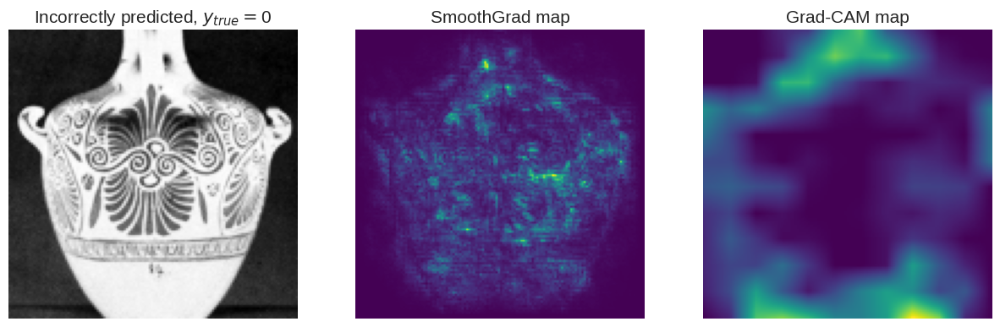

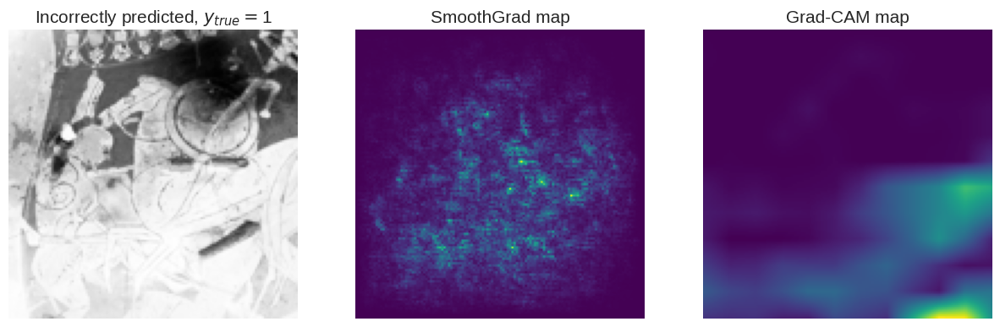

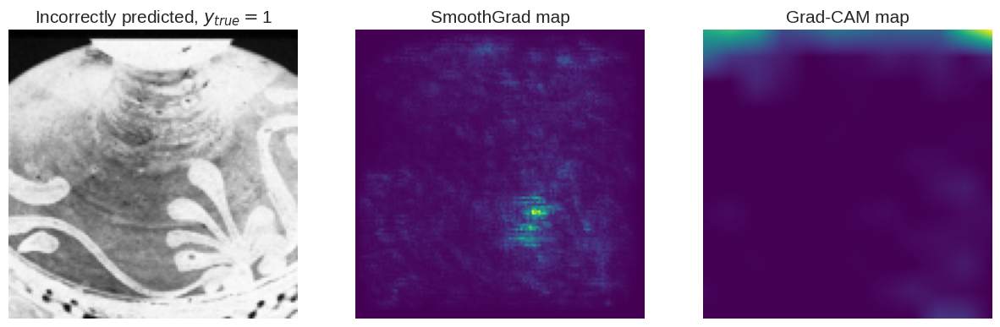

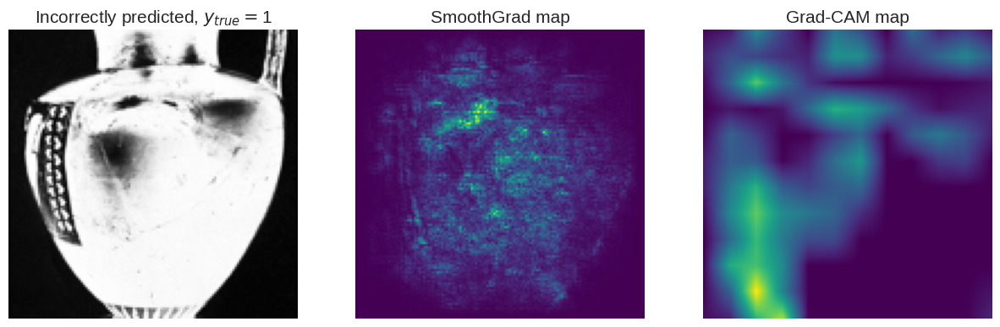

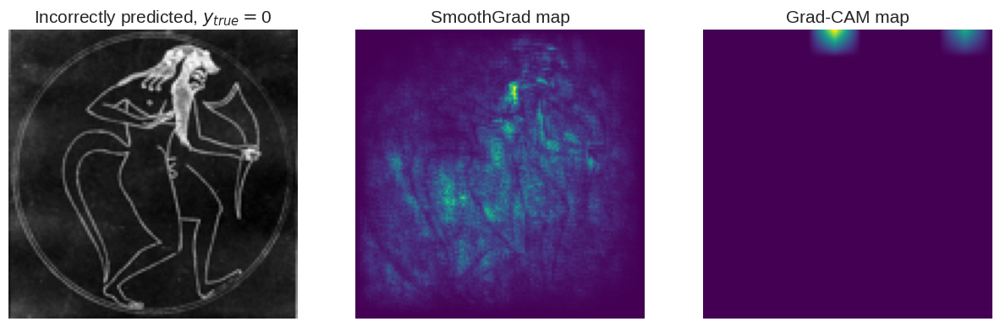

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  incorrec_img_sh = incorrect_preds_sh[i]
  true_label_sh = int(true_labs_sh[i])
  GCSG(incorrec_img_sh, true_label_sh,'Incorrect', model3a, 10)

<Figure size 640x480 with 0 Axes>

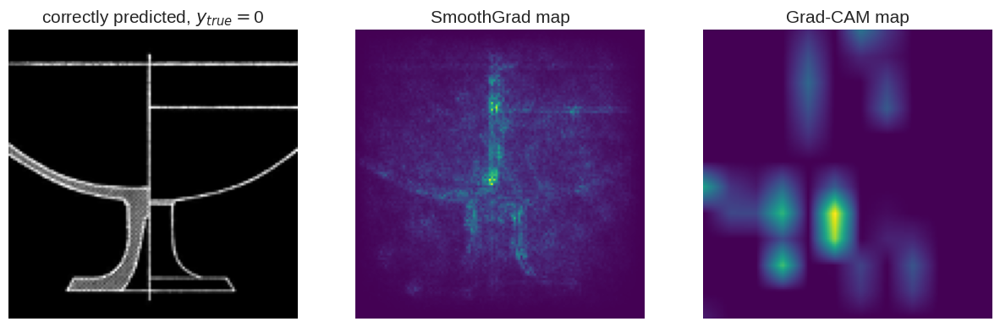

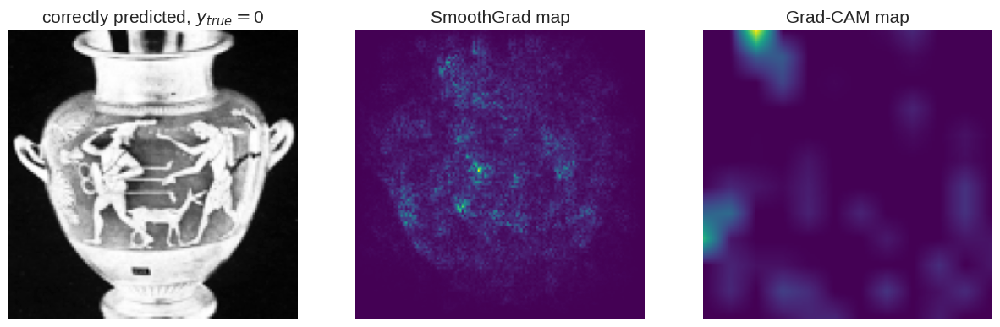

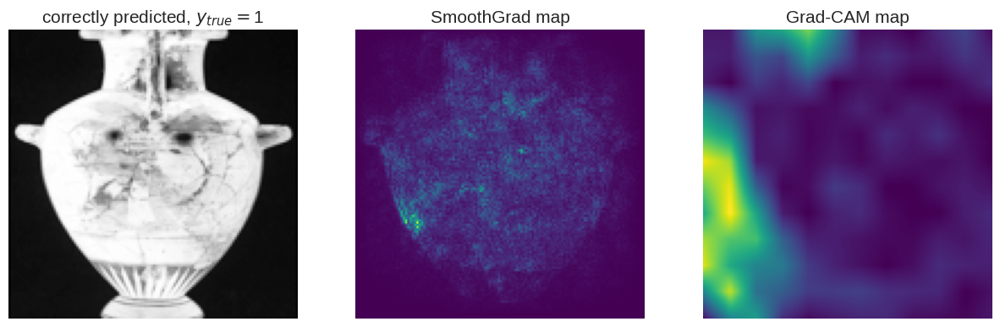

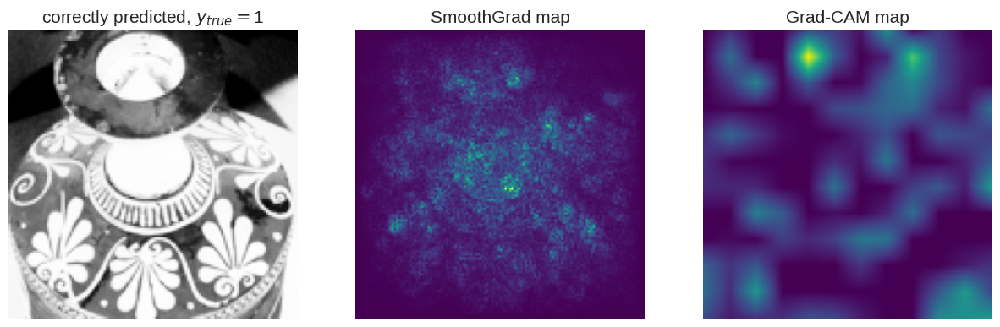

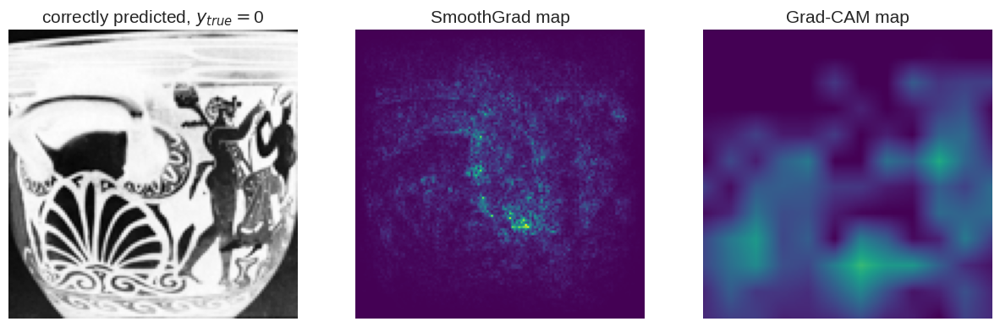

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  correc_img_sh = correct_preds_sh[i]
  true_label_sh = int(true_labs_sh[i])
  GCSG(correc_img_sh, true_label_sh,'correct', model3a, 10)

#### Satyr Final Model

Since the last layer before dense layers are maxpooling layers, the satyr Smooth Grad maps look like a set of grids. For GradCam, we do not necessarily look at the maxpooling, but specifically took one of the convolutional layers when we created the function. From the SmoothGrad map, we definitely seem to be learning focusing on humans or groups of humans in vases, but the model often thinks that satyrs are humans or the other way around. For some reason it also focuses on round edges, using the wrong information and reaching the right conclusion, which is interesting. This inability to distinguish the two types of objects might explain why training this type of model was especially difficult and the accuracy is still limited.

<Figure size 640x480 with 0 Axes>

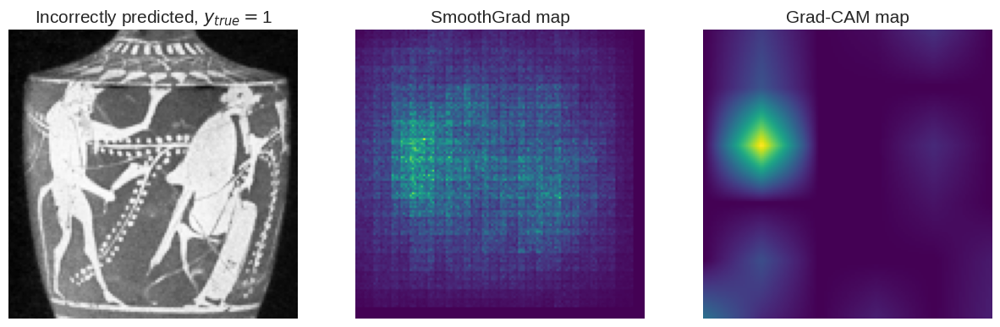

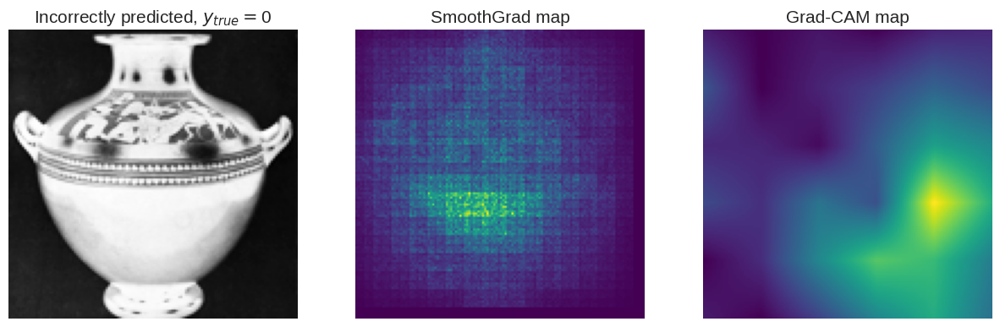

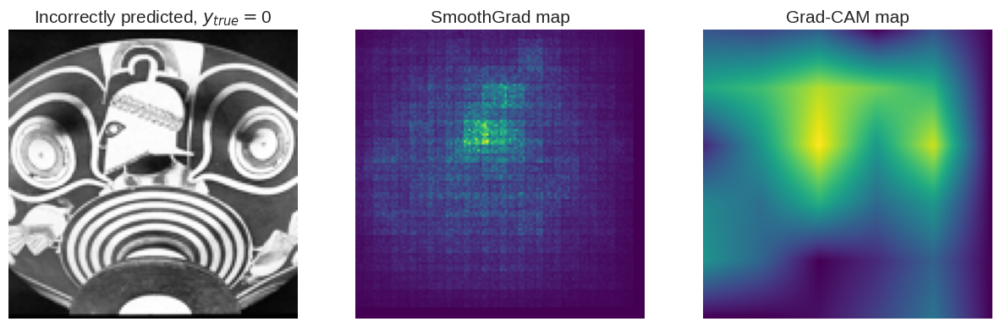

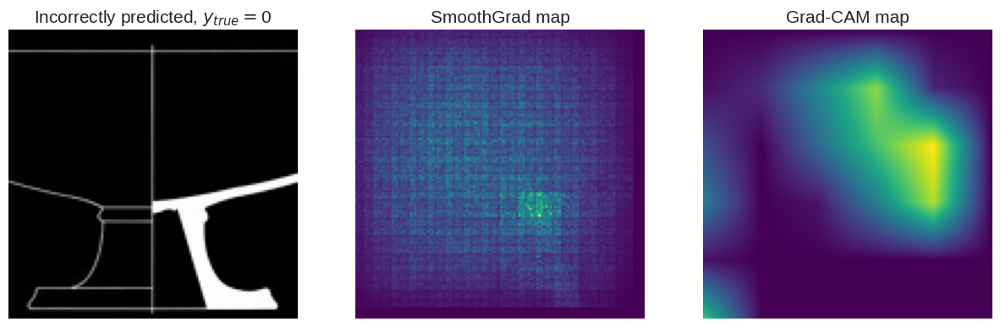

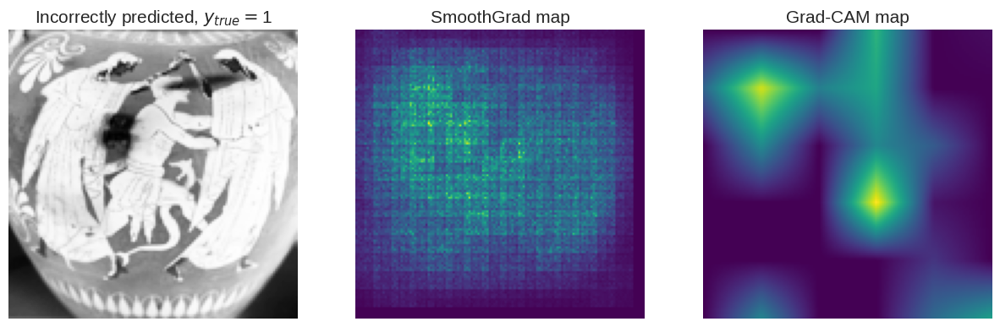

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  incorrec_img_sat = incorrect_preds_sat[i]
  true_label_sat = int(true_labs_sat[i])
  GCSG(incorrec_img_sat, true_label_sat,'Incorrect', model3b, 10)

<Figure size 640x480 with 0 Axes>

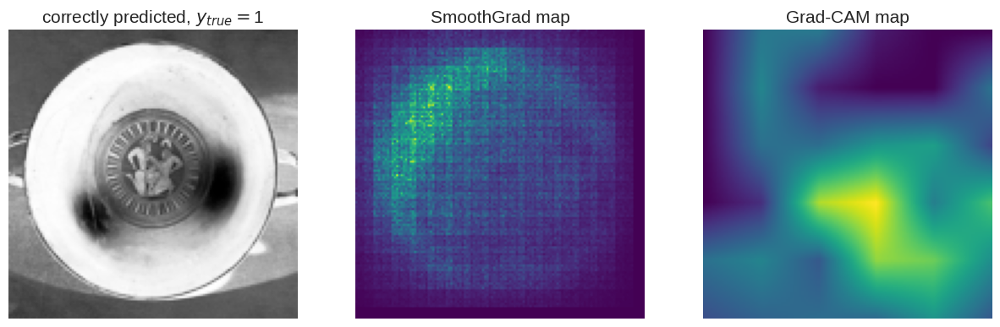

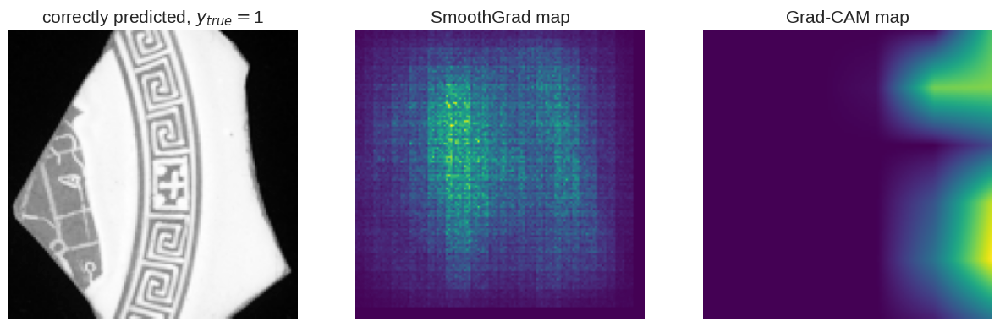

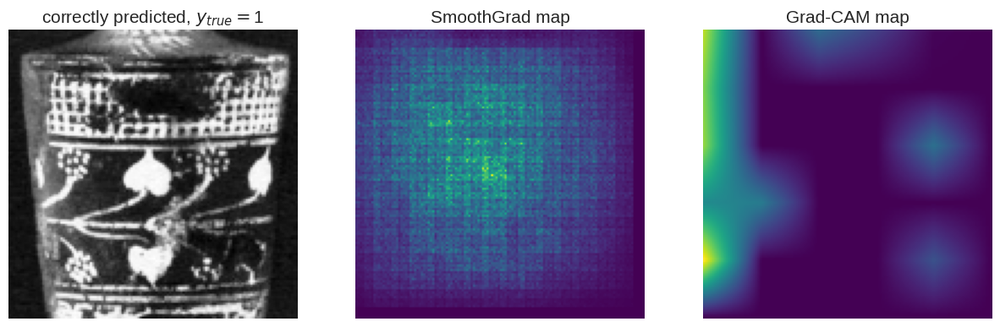

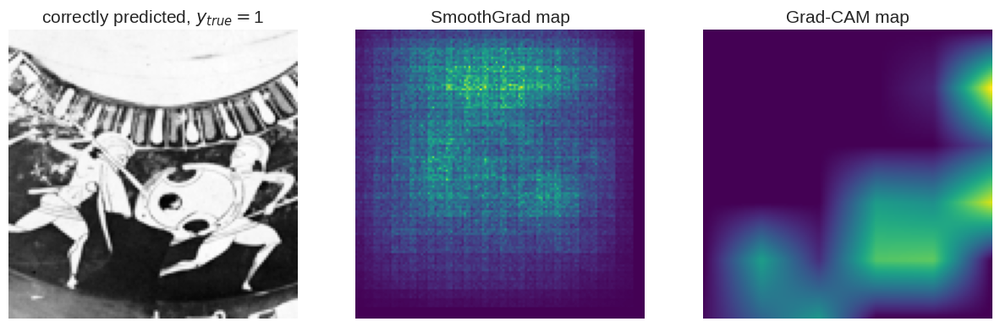

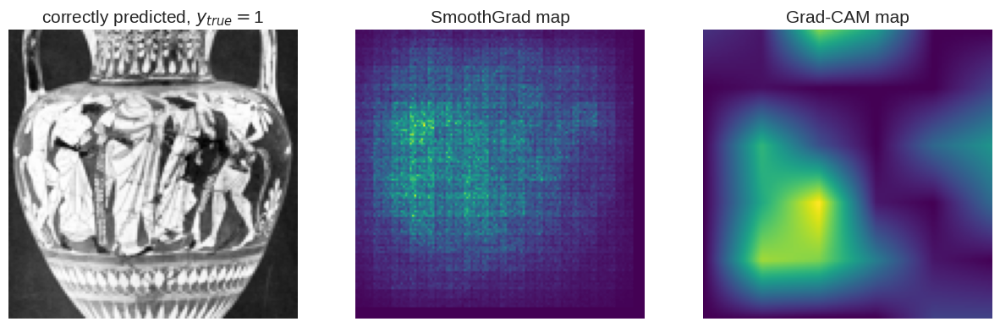

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  correc_img_sa = correct_preds_sat[i]
  true_label_sa = int(true_labs_sat[i])
  GCSG(correc_img_sa, true_label_sa,'correct', model3b, 10)

#### Chariot Final Model

From the SmoothGrad and the Grad-CAM maps, we definitly seem to be focusing on the figures painted on the vase but sometimes reach the wrong conclusion.Geometric patterns and a collection of shades seem to be important in determining chariots. Different positions of horses, e.g., facing us instead of the front seem to confuse our model. We seem to focus on the horses, but not pick up on the chariot behind them. Some wrong predictions are again due to the limitations with respect to the modeling of vases and not all images containing the object of interest.

<Figure size 640x480 with 0 Axes>

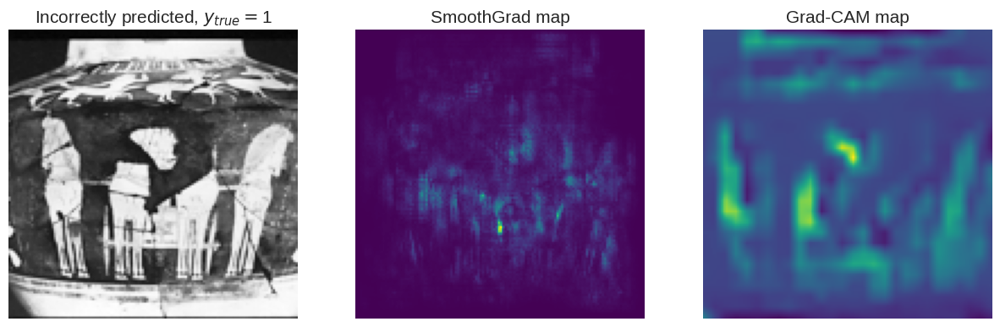

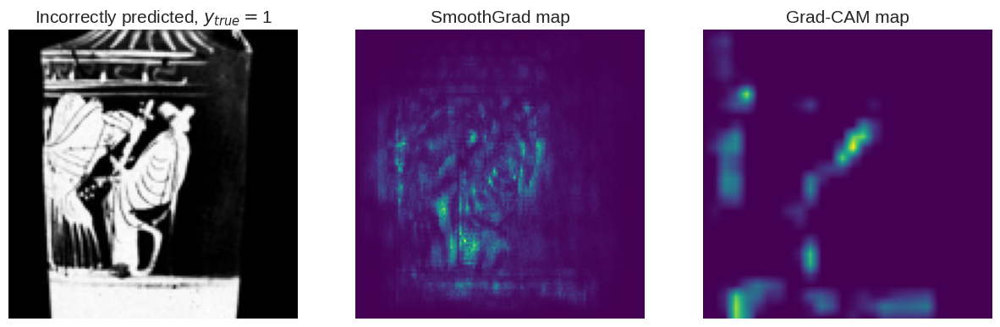

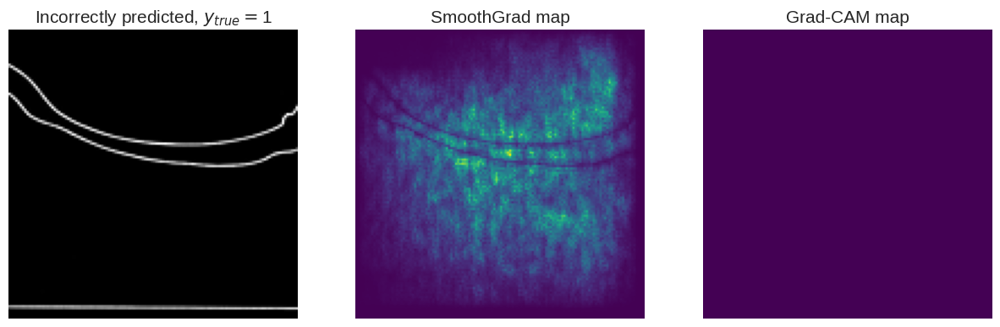

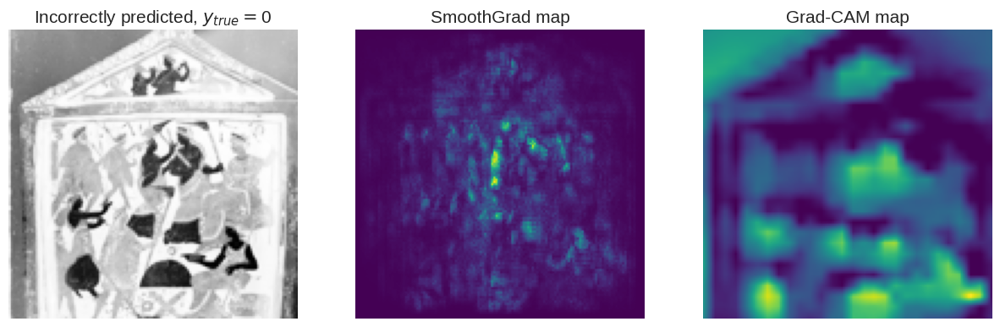

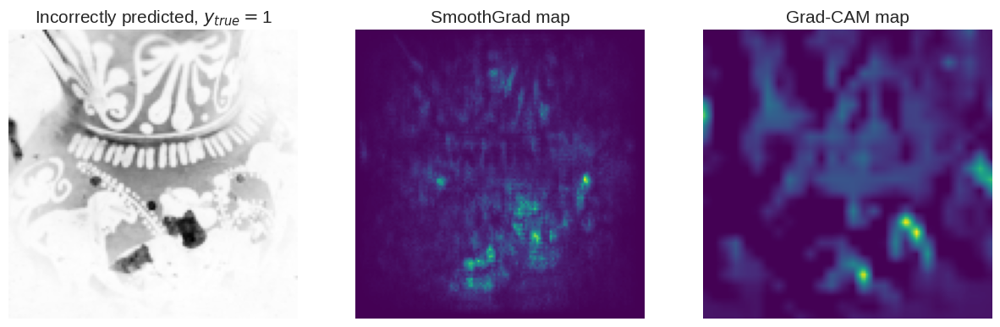

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  incorrec_img_ch = incorrect_preds_ch[i]
  true_label_ch = int(true_labs_ch[i])
  GCSG(incorrec_img_ch, true_label_ch,'Incorrect', model3c, 7)

<Figure size 640x480 with 0 Axes>

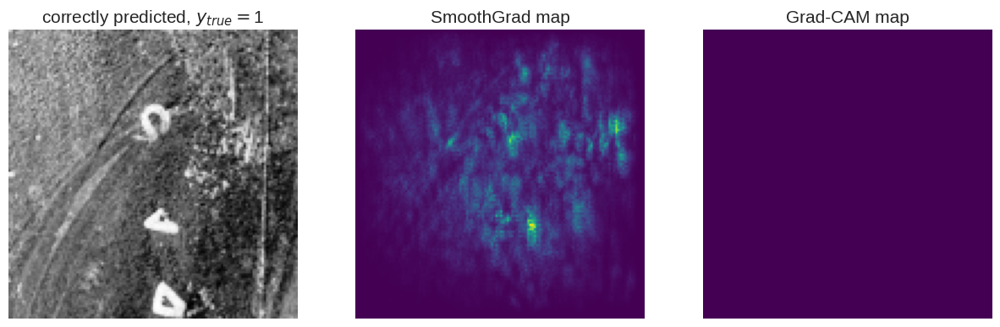

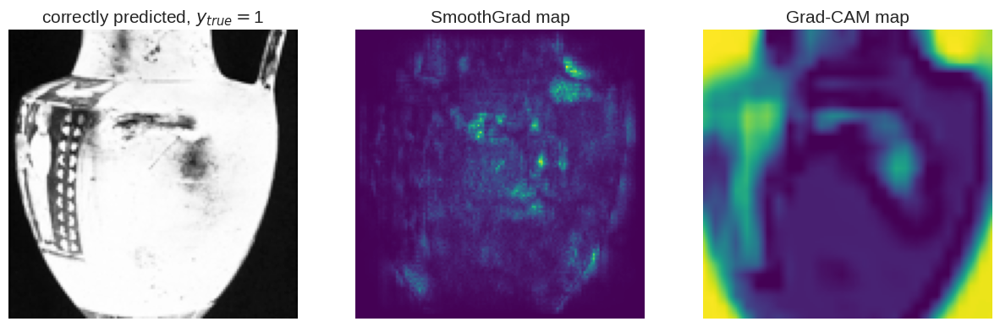

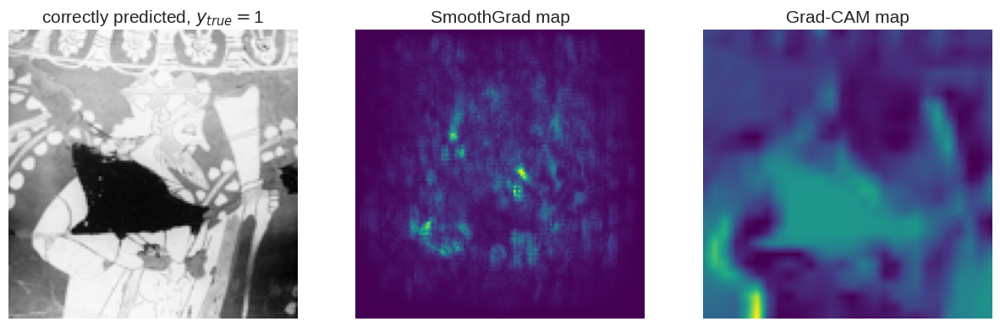

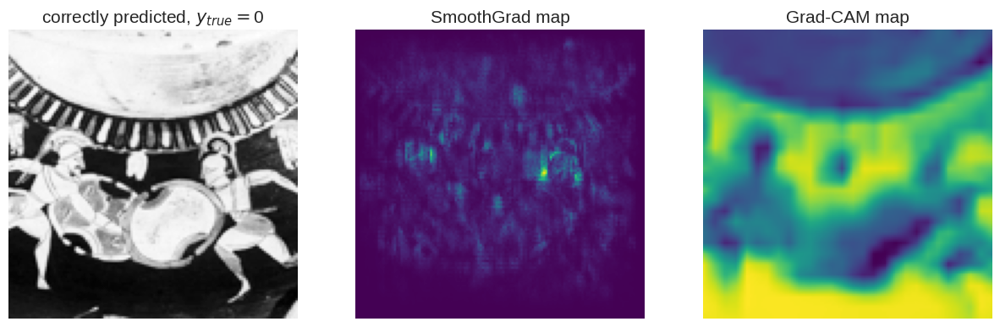

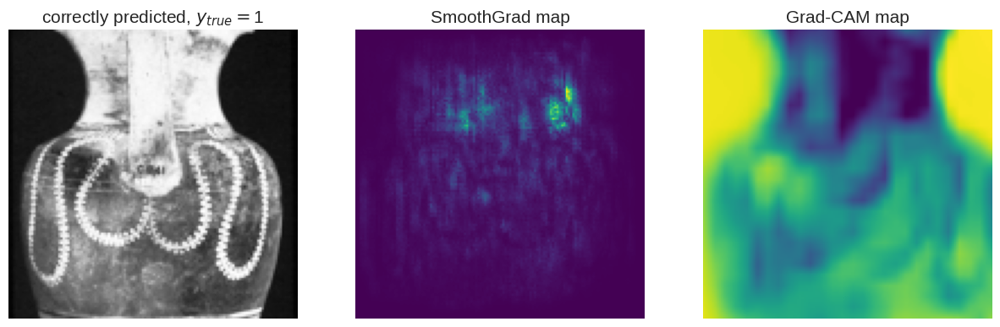

In [ ]:
plt.tight_layout()
plt.show()
for i in range(0,5):
  correc_img_ch = correct_preds_ch[i]
  true_label_ch = int(true_labs_ch[i])
  GCSG(correc_img_ch, true_label_ch,'correct', model3c, 7)

### Performance in unseen data

To use as our test data we load in a third batch of data that we have and evaluate our three models there. This loads an additional 10,000 images. To create our test dataset we also make sure that we have a balanced test set so we grab all of the vases with the object of interest and then the same number of vases without the object. This gives us an idea of out of sample performance, even if we are very aware of the limitations of our modeling approach.

In [ ]:
# defining categories in new dataset
batch_test = File_Path_3 + 'clean_images_complete_2_' + str(3) + '.npy'
batch_load_test = np.load(batch_test)
new_df_test = pd.read_csv(File_Path_2 + 'new_df_large_complete_2.csv')
new_df_test = new_df_test.iloc[20000:30000]

new_df_test['Chariot'] = 1*(new_df_test['Decoration'].str.contains('CHARIOT'))
new_df_test['Shield'] = 1*(new_df_test['Decoration'].str.contains('SHIELD'))
new_df_test['Satyr'] = 1*(new_df_test['Decoration'].str.contains('SATYR'))

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (15,20) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
def get_test_data(df, images, cat, shapes = True):
  # get ids for some cat(ex. chariots) images
  cat_ids = df["id"][df[cat]==1].unique()
  # get ids for same number of non-cat(ex. shields) images
  noncat_ids = df["id"][df[cat]==0].unique()[:len(cat_ids)]
  # combine into list of unique ids
  unique_ids = [*cat_ids, *noncat_ids]

  # Get X, y arrays
  X = images.reshape(-1, resize_size, resize_size, 1)
  y = df[cat].values.astype('float32')

  # Get train and test data
  X_test = tf.convert_to_tensor(X[df['id'].isin(unique_ids)])
  y_test = tf.convert_to_tensor(y[df['id'].isin(unique_ids)])

  if shapes:
    print('----------------------------------------')
    print(f'Category: {cat}')
    print(f'Size of test_X: {X_test.shape}')
    print(f'Size of test_y: {y_test.shape}')

  # Create dataset
  test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))
  test_dataset = test_dataset.batch(256)

  return (test_dataset)
  

In [ ]:
import tensorflow as tf
test_data_shield= get_test_data(new_df_test, batch_load_test, "Shield")
test_data_satyr = get_test_data(new_df_test, batch_load_test, "Satyr")
test_data_chariot = get_test_data(new_df_test, batch_load_test, "Chariot")

del new_df_test
del batch_load_test

----------------------------------------
Category: Shield
Size of test_X: (807, 128, 128, 1)
Size of test_y: (807,)
----------------------------------------
Category: Satyr
Size of test_X: (1478, 128, 128, 1)
Size of test_y: (1478,)
----------------------------------------
Category: Chariot
Size of test_X: (998, 128, 128, 1)
Size of test_y: (998,)


As we can see our tests datasets are relatively small, so evaluation of our models might be limited. Each validation set only has a couple hundred images of chariots, which might mean that our performance might be especially poor if for some reason the images in this set are significantly different than the ones we used to train.

While we cannot be sure that this is the reason, our performance in our test data is very poor. This could mean that overfitting might be a bigger problem than we previously thought or that the modeling is hindered more by the particulars of the data than we thought. 

In [ ]:
results_1 = model3a.evaluate(test_data_shield, batch_size=256)
print(f"The test accuracy is {results_1[1]}")

4/4 [==============================] - 7s 1s/step - loss: 2.5390 - accuracy: 0.5143
The test accuracy is 0.5142503380775452


In [ ]:
results_2 = model3b.evaluate(test_data_satyr, batch_size=256)
print(f"The test accuracy is {results_2[1]}")

6/6 [==============================] - 11s 2s/step - loss: 0.6902 - accuracy: 0.5440
The test accuracy is 0.5439783334732056


In [ ]:
results_3 = model3c.evaluate(test_data_chariot, batch_size=256)
print(f"The test accuracy is {results_3[1]}")

4/4 [==============================] - 6s 1s/step - loss: 1.1628 - accuracy: 0.4679
The test accuracy is 0.46793586015701294


Depending on the iteration of the data, most test set performances of all three models oscillate between 0.47 and 0.54. Given this variation each time we re run the entire notebook, we discuss this performance in general terms, but do not modify our models further since that would be trying to overfit to the test data. While we are overfitting to the training and to some extent the validation data, how much we seem to overfit depends on the run. The model architecture seems to perform relatively well in previous steps, even if the test performance is poor. 

# Discussion


## Overall performance of the models

While the performance in the validation seems to be between 55 and 60 percent for our final models, the performance of our models in the tests sets seems to be especially poor. From the saliency maps, we learn that our model is looking at the drawings on the vases and not other features like the background or the shape of the vase. This is reassuring that at least our model is looking at the information we are interested in using. Since our accuracy is low, the question is if there might be too little variation in our train and validation data to generalize better to the test data or if there are other data related problems that cause the performance of the models to be so poor. 

While there might be over 100,000 images in the data archive, it is impossible for us to download or load all of them in. In our case, if we loaded in more than 30,000, we started running into issues in terms of memory. The number of images that then contain the objects of interest is only a small fraction of the images we are able to load. The number of vases with the objets determines how much data we keep of the images without the objects in order to balance the data since we do not want to have a good model that just predicts that there is no object for all of the outcomes. Being able to access more data containing the objects of interest might help to verify whether the poor performance in the test set is related to low variation in how objects are represented in the vases. While the amount of vases with data and memory can cause issues, this is not the main reason we think that the performance of our model is limited. 


We can see in the saliency maps that we are indeed looking at the drawings to make decision. In part it is reassuring to see that at closer inspection some predictions that we predict as wrong are actually correct, but this illustrates the limitations of the approach rather than give reassurance. This brings attention to accuracy in the context of the data and how the structure of the data gives us an unclear image of what the real accuracy of our models are and might hinder our training.

## Limitations


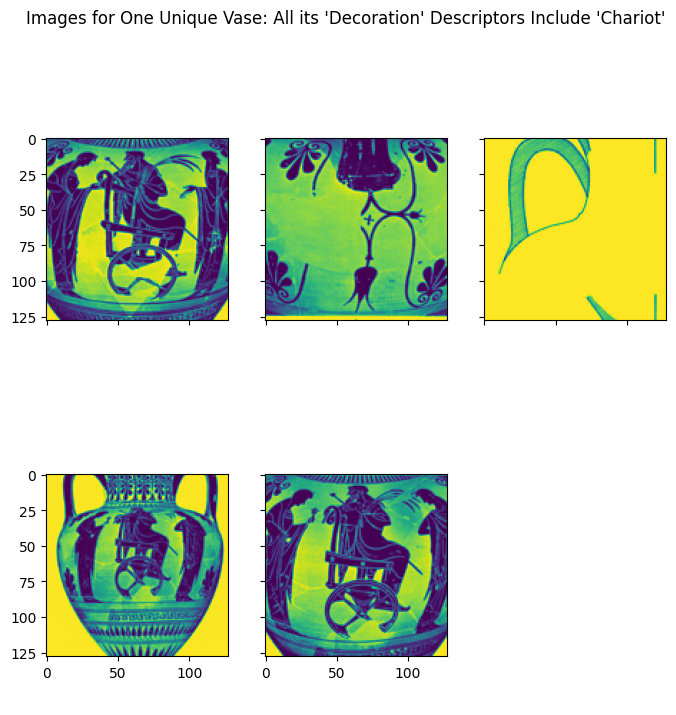

In [ ]:
#show images for just first vase, all have chariot in description (but not all images have chariot)
plt.style.use('default')
fig, axs = plt.subplots(2,3,figsize=(8,8), sharex=True, sharey=True)
fig.suptitle("Images for One Unique Vase: All its 'Decoration' Descriptors Include 'Chariot'")
for i,ax in enumerate(axs.flat):
    if i < 5:
      ax.imshow(clean_images[i])
    if i == 5:
      ax.set_axis_off()

Though there are several aspects of our model design that may lead to shortcomings or deficiencies in the results, the primary limitation involves the structure of the Arms and Armor metadata. To illustrate the issue, consider the above five images: all five depict the same vase from different angles, and all five have the Decoration description, “A,B: TRIPTOLEMOS ON WINGED CHARIOT BETWEEN DEMETER AND PERSEPHONE.” Accordingly, all five images are classified as having a ‘CHARIOT’ in them, so the respective binary classifier column ‘chariot’ in our data set is set to 1. However, it is immediately evident from the images above that only three of the five images for this vase actually have a chariot in them, while the other two depict portions of the vase that do not show any chariots. 


This dynamic of the data set is a major structural problem. Since each unique vase has a varying number of images depicting varying angles of the vase, every vase that has a chariot in its imagery likely has at least one associated image in the data set that is described as showing a chariot while not actually showing a chariot at all. Once we begin training our neural networks, then, it is no surprise that performance suffers – during training, the model is repeatedly being told there are chariots in the image when, for many images, there simply are not. Sometimes, sketches of the vases or other notes are included but we found no straightforward way to distinguish them from each other. The order of images of the same vase had no pattern that was easy for us to recognize to be able to only use relevant images from each vase.


Such an issue extends to the satyr and shield models as well. In general, because the ‘Decoration’ attribute is determined by vase rather than image, any predictive classifier using this attribute to create the binary y-variable for images will encounter significant training difficulties and thus poor model results. 


One partial solution would be to define an alternate form of accuracy – if, for example, the model classifies at least one of the images for a particular vase as having a certain decoration attribute, then all the images for that model would be classified with having the attribute, otherwise they would be classified as not having the attribute. However, while this form of accuracy is more in-line with the current data structure (same decoration description for every image of a given vase), it still does not solve the unsound training of the model using incorrectly classified individual vase images. Going forward, any attempt to improve our models from above would almost certainly entail developing work-arounds for this limitation. 


# Conclusion

In trying to build classifiers that identify three categories of objects – chariots, satyrs, and shields – within Greek vase imagery, our project succeeds with respect to some of these categories more than others. For example, our baseline model for identifying chariots generates 55% accuracy on the validation set, which is not insubstantial. At the same time, this is likely not high enough of an accuracy for, say, a researcher to use the model in order to effectively identify chariots in a large swathe of images with missing descriptions. Moreover, as mentioned in the limitations section above, due to the structure of the Arms and Armor database, building classifier models with the existing Decoration descriptions is fundamentally flawed. Still, our project is a valuable first step in the creation of these sorts of tools. 

A better strategy to build these models, might be to manually go through each image and add a description or checkbox for possible tags for a subset of 10,000 images and build models based on these. This is extremely time consuming but this manual data labor might be necessary to build models so that afterwards we can use machine learning to create tags for images that do not have them.

# Bibliography

[1] Bershadsky, Natasha. “Proposal for CS109B Projects: Visual Recognition of Images on Ancient Greek Vases,” n.d.